In [155]:
import os
from glob import glob
import cv2

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sea

from sklearn.model_selection import train_test_split
from keras.preprocessing.image import ImageDataGenerator



import tensorflow as tf
import tensorflow.keras as keras
from keras.models import Model, Sequential
from tensorflow.keras.utils import plot_model
import tensorflow.keras.layers as Layers
from keras.layers import Layer
import keras.backend as K

# CUDA Setup

In [156]:
physical_devices = tf.config.experimental.list_physical_devices('GPU')
if len(physical_devices) > 0:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)

# Define Custom Metrics

In [157]:
WIDTH = 128
HEIGHT = 128

In [158]:
smooth = 100
def iou(y_true, y_pred):
    intersection = K.sum(y_true * y_pred)
    sum_ = K.sum(y_true + y_pred)
    jac = (intersection + smooth) / (sum_ - intersection + smooth)
    return jac

def dice_coef(y_true, y_pred):
    y_truef = K.flatten(y_true)
    y_predf = K.flatten(y_pred)
    And = K.sum(y_truef * y_predf)
    return((2 * And + smooth) / (K.sum(y_truef) + K.sum(y_predf) + smooth))


# Build Network

In [188]:
class EncoderBlock(keras.layers.Layer):

    def __init__(self, filters, rate, pooling=True, **kwargs):
        super(EncoderBlock,self).__init__(**kwargs)
        
        self.filters = filters
        self.rate = rate
        self.pooling = pooling
        
        self.conv1 = Layers.Conv2D(self.filters,kernel_size=3,strides=1,padding='same',activation='relu',kernel_initializer='he_normal')
        self.drop = Layers.Dropout(rate)
        self.conv2 = Layers.Conv2D(self.filters,kernel_size=3,strides=1,padding='same',activation='relu',kernel_initializer='he_normal')
        self.pool = Layers.MaxPool2D(pool_size=(2,2))

    def call(self, inputs):
        x = self.drop(self.conv1(inputs))
        x = self.conv2(x)
        if self.pooling: 
            y = self.pool(x)
            return y, x
        else:
            return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config, 
            "filters":self.filters,
            "rate":self.rate,
            "pooling":self.pooling
        }

class DecoderBlock(Layer):
    
    def __init__(self, filters, rate, **kwargs):
        super(DecoderBlock, self).__init__(**kwargs)
        
        self.filters = filters
        self.rate = rate
        
        self.bn = Layers.BatchNormalization()
        self.cT = Layers.Conv2DTranspose(filters, kernel_size=3, strides=2, padding='same', activation='relu', kernel_initializer="he_normal")
        self.net = EncoderBlock(filters, rate, pooling=False)
        
    def call(self, X):
        x, skip_x = X
        x = self.bn(x)
        x = self.cT(x)
        x = Layers.concatenate([x, skip_x])
        x = self.net(x)
        return x
            
    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            "rate":self.rate,
        }

class AttentionGate(Layer):

    def __init__(self, filters, **kwargs):
        super(AttentionGate, self).__init__(**kwargs)
        
        self.filters = filters
        
        self.normal = Layers.Conv2D(filters, kernel_size=3, padding='same', activation='relu', kernel_initializer='he_normal')
        self.down = Layers.Conv2D(filters, kernel_size=3, strides=2, padding='same', activation='relu', kernel_initializer='he_normal')
        self.resample = Layers.UpSampling2D()
        self.c = Layers.Conv2D(1, kernel_size=1, padding='same', activation='sigmoid')        
        
    def call(self, X):
        x, skip_x = X
        
        x = self.normal(x)  # normally pass the previous decoder inputs through a convolutional layer.
        skip = self.down(skip_x)  # downsample the Skip connections as they are larger in size.
        
        x = Layers.add([x, skip])  # add both the skip connections and the previous decoder outputs.
        x = self.c(x)      # pass it through a convolutional layer that is responsible for learning the importance factors.
        x = self.resample(x)  # upsample the image.
         
        skip_x = Layers.multiply([x, skip_x])  # Apply the learnt importance factors.
        return skip_x
        
    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters
        }

# Inputs
unet_input = Layers.Input(shape=(WIDTH, HEIGHT, 3), name="UnetInput")

# Encoder - Downsampling Phase
p1, c1 = EncoderBlock(64, 0.1, name="Encoder1")(unet_input)
p2, c2 = EncoderBlock(128, 0.1, name="Encoder2")(p1)
p3, c3 = EncoderBlock(256, 0.2, name="Encoder3")(p2)
p4, c4 = EncoderBlock(512, 0.2, name="Encoder4")(p3)

# Encoding - Latent Representation
e = EncoderBlock(512, 0.3, pooling=False, name="Encoding")(p4)

#  Attention plus decoder network.
a1 = AttentionGate(512,name="Attention1")([e, c4])
d1 = DecoderBlock(512,0.2,name="Decoder1")([e, a1])

a2 = AttentionGate(256,name="Attention2")([d1, c3])
d2 = DecoderBlock(256,0.2,name="Decoder2")([d1, a2])

a3 = AttentionGate(128,name="Attention3")([d2, c2])
d3 = DecoderBlock(128,0.1,name="Decoder3")([d2, a3])

a4 = AttentionGate(64,name="Attention4")([d3, c1])
d4 = DecoderBlock(64,0.1,name="Decoder4")([d3, a4])

unet_out = Layers.Conv2D(3, kernel_size=3, padding='same', activation='sigmoid', name="UNetOut")(d4)

# Model
aunet = Model(
    inputs=unet_input,
    outputs=unet_out,
    name="Unet"
)



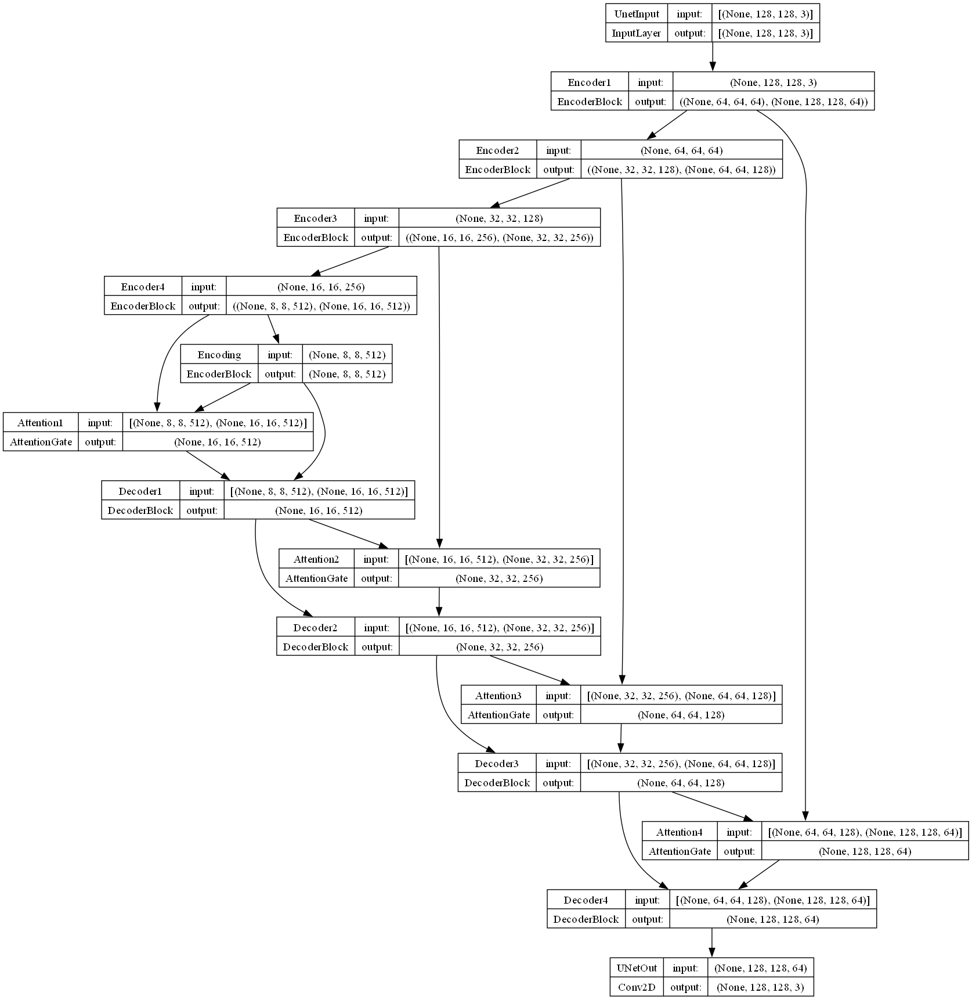

In [189]:
plot_model(
    aunet, 
    show_shapes = True,
    show_dtype=False,
    show_layer_names = True, 
    rankdir = 'TB', 
    expand_nested = False, 
    dpi = 100
)

In [161]:
def build_unet(dropout):
    
    input = Layers.Input((WIDTH, HEIGHT, 3))
    conv1_1 = Layers.Conv2D(32, 3, activation = 'relu', padding = 'same')(input)
    drop1_1 = Layers.Dropout(dropout)(conv1_1)
    conv1_2 = Layers.Conv2D(32, 3, activation = 'relu', padding = 'same')(drop1_1)
    drop1_2 = Layers.Dropout(dropout)(conv1_2)
    
    pool1 = Layers.MaxPooling2D(pool_size=(2, 2))(drop1_2)
    conv2_1 = Layers.Conv2D(64, 3, activation = 'relu', padding = 'same')(pool1)
    drop2_1 = Layers.Dropout(dropout)(conv2_1)
    conv2_2 = Layers.Conv2D(64, 3, activation = 'relu', padding = 'same')(drop2_1)
    drop2_2= Layers.Dropout(dropout)(conv2_2)

    pool2 = Layers.MaxPooling2D(pool_size=(2, 2))(drop2_2)
    conv3_1 = Layers.Conv2D(128, 3, activation = 'relu', padding = 'same')(pool2)
    drop3_1 = Layers.Dropout(dropout)(conv3_1)
    conv3_2 = Layers.Conv2D(128, 3, activation = 'relu', padding = 'same')(drop3_1)
    drop3_2 = Layers.Dropout(dropout)(conv3_2)
    
    pool3 = Layers.MaxPooling2D(pool_size=(2, 2))(drop3_2)
    conv4_1 = Layers.Conv2D(256, 3, activation = 'relu', padding = 'same')(pool3)
    drop4_1 = Layers.Dropout(dropout)(conv4_1)
    conv4_2 = Layers.Conv2D(256, 3, activation = 'relu', padding = 'same')(drop4_1)
    drop4_2 = Layers.Dropout(dropout)(conv4_2)
    
    pool4 = Layers.MaxPooling2D(pool_size=(2, 2))(drop4_2)
    conv5_1 = Layers.Conv2D(512, 3, activation = 'relu', padding = 'same')(pool4)
    drop5_1 = Layers.Dropout(dropout)(conv5_1)
    conv5_2 = Layers.Conv2D(512, 3, activation = 'relu', padding = 'same')(drop5_1)
    drop5_2 = Layers.Dropout(dropout)(conv5_2)

    up1 = Layers.Conv2D(256, 2, activation = 'relu', padding = 'same')(Layers.UpSampling2D(size = (2,2))(drop5_2))
    merge1 = Layers.concatenate([drop4_2, up1], axis = 3)
    conv6_1 = Layers.Conv2D(256, 3, activation = 'relu', padding = 'same')(merge1)
    drop6_1 = Layers.Dropout(dropout)(conv6_1)
    conv6_2 = Layers.Conv2D(256, 3, activation = 'relu', padding = 'same')(drop6_1)
    drop6_2 = Layers.Dropout(dropout)(conv6_2)

    up2 = Layers.Conv2D(128, 2, activation = 'relu', padding = 'same')(Layers.UpSampling2D(size = (2,2))(drop6_2))
    merge2 = Layers.concatenate([drop3_2, up2], axis = 3)
    conv7_1 = Layers.Conv2D(128, 3, activation = 'relu', padding = 'same')(merge2)
    drop7_1 = Layers.Dropout(dropout)(conv7_1)
    conv7_2 = Layers.Conv2D(128, 3, activation = 'relu', padding = 'same')(drop7_1)
    drop7_2 = Layers.Dropout(dropout)(conv7_2)

    up3 = Layers.Conv2D(64, 2, activation = 'relu', padding = 'same')(Layers.UpSampling2D(size = (2,2))(drop7_2))
    merge3 = Layers.concatenate([drop2_2, up3], axis = 3)
    conv8_1 = Layers.Conv2D(64, 3, activation = 'relu', padding = 'same')(merge3)
    drop8_1 = Layers.Dropout(dropout)(conv8_1)
    conv8_2 = Layers.Conv2D(64, 3, activation = 'relu', padding = 'same')(drop8_1)
    drop8_2 = Layers.Dropout(dropout)(conv8_2)
    
    up4 = Layers.Conv2D(32, 2, activation = 'relu', padding = 'same')(Layers.UpSampling2D(size = (2,2))(drop8_2))
    merge4 = Layers.concatenate([drop1_2, up4], axis = 3)
    conv9_1 = Layers.Conv2D(32, 3, activation = 'relu', padding = 'same')(merge4)
    drop9_1 = Layers.Dropout(dropout)(conv9_1)
    conv9_2 = Layers.Conv2D(32, 3, activation = 'relu', padding = 'same')(drop9_1)
    drop9_2 = Layers.Dropout(dropout)(conv9_2)
    
    output = Layers.Conv2D(3, (1,1), activation = 'sigmoid')(drop9_2)
    
    return keras.models.Model(inputs = input, outputs = output)


model = build_unet(0.2)


In [162]:
# model.summary()

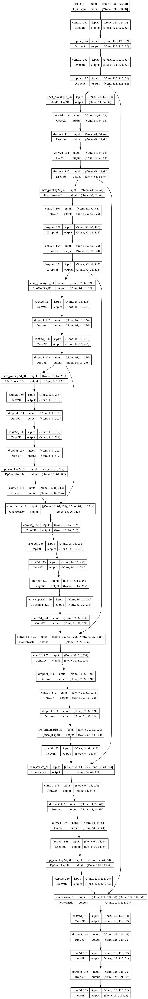

In [163]:
plot_model(
    model, 
    show_shapes = True,
    show_dtype=False,
    show_layer_names = True, 
    rankdir = 'TB', 
    expand_nested = False, 
    dpi = 100
)

# Read Data

In [164]:
def read_image(image_path, mask_path):
	resize = lambda x: tf.image.resize(x, [WIDTH, HEIGHT], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
	normalize = lambda x: (x / 255)

	image = tf.io.read_file(image_path)
	image = tf.image.decode_jpeg(image, channels=3)
	mask = tf.io.read_file(mask_path)
	mask = tf.image.decode_bmp(mask, channels=3)

	image = tf.cast(image, tf.float32)
	mask = tf.cast(mask, tf.float32)

	image = normalize(resize(image))
	mask = normalize(resize(mask))

	return image, mask

In [165]:
def data_path(root):
	image_paths = sorted(glob(root + 'images/' + "*.jpg"))
	mask_paths = sorted(glob(root + 'masks/' + "*.bmp"))

	return pd.DataFrame(data={
		'image': image_paths,
		'mask': mask_paths
	})


In [166]:
train = data_path('../data/SUIM/train_val/')
test = data_path('../data/SUIM/test/')


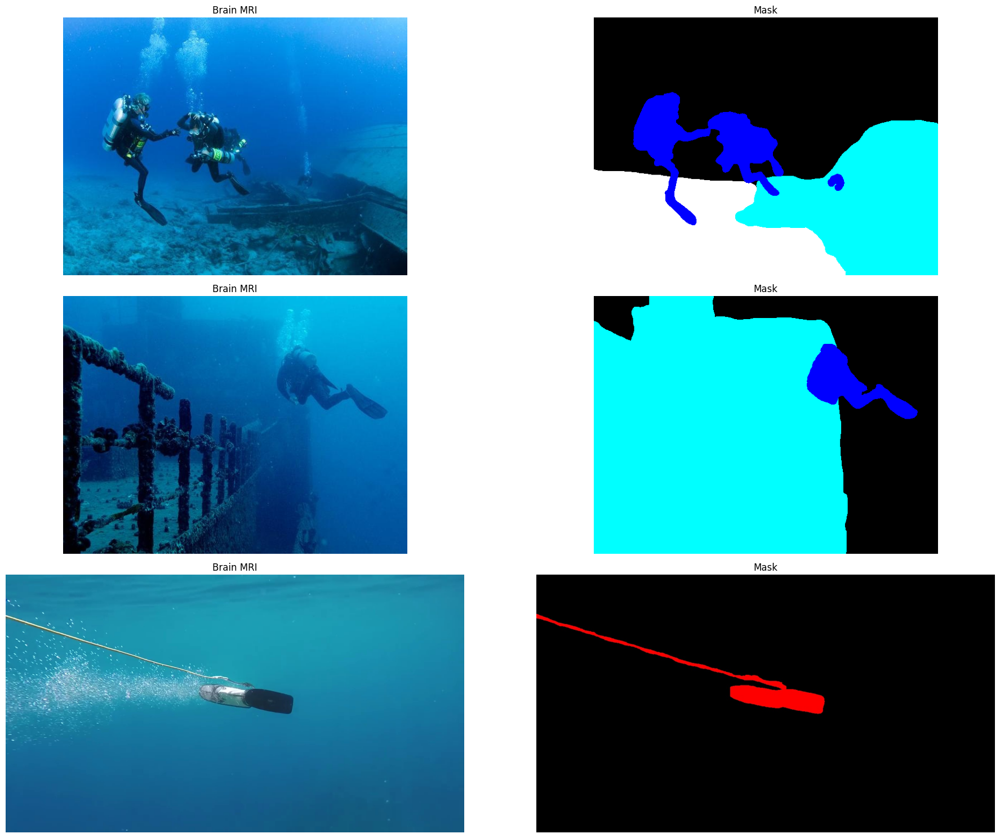

In [167]:
fig, axs = plt.subplots(3, 2, figsize=(20,15))
pos = train
for i in range(3):
	img = cv2.imread(pos.iloc[i]['image'])
	img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
	axs[i][0].title.set_text("Brain MRI")
	axs[i][0].axis('off')
	axs[i][0].imshow(img)
	
	mask = cv2.imread(pos.iloc[i]['mask'])
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)
	axs[i][1].title.set_text('Mask')
	axs[i][1].axis('off')
	axs[i][1].imshow(mask, cmap='gray')
	
        
fig.tight_layout()
plt.show()

# Prepare Data for Network

In [168]:
def adjust_data(img, mask):
    img = img / 255.0
    mask = mask / 255.0
    return img, mask

In [170]:
def data_generator(dataframe, batch_size, aug_dict):

    target_size = (WIDTH, HEIGHT)
    seed = 42
    image_datagen = ImageDataGenerator(**aug_dict)
    mask_datagen = ImageDataGenerator(**aug_dict)
    
    image_generator = image_datagen.flow_from_dataframe(
        dataframe,
        x_col = 'image',
        class_mode = None,
        color_mode = 'rgb',
        target_size = target_size,
        batch_size = batch_size,
        seed = seed
    )

    mask_generator = mask_datagen.flow_from_dataframe(
        dataframe,
        x_col = 'mask',
        class_mode = None,
        color_mode = 'rgb',
        target_size = target_size,
        batch_size = batch_size,
        seed = seed
    )

    train_gen = zip(image_generator, mask_generator)
    
    for (img, mask) in train_gen:
        img, mask = adjust_data(img, mask)
        yield (img, mask)

In [171]:
train, valid = train_test_split(train, test_size=0.1, random_state=42)


# Data Augmentation

- `rotation_range`: Specify the range of degrees for random rotations applied to the images and masks. This can help introduce diversity in the dataset and make the model more robust to different orientations.

- `width_shift_range` and `height_shift_range`: Define the range as a fraction of total width or height within which to randomly translate the images and masks horizontally or vertically. This augmentation can simulate slight movements or shifts in the objects of interest.

- `shear_range`: Apply random shearing transformations to the images and masks. Shearing can distort the objects and add variability to the dataset, helping the model generalize better.

- `zoom_range`: Randomly zoom the images and masks within a specified range. This augmentation can simulate different scales of objects and improve the model's ability to handle variations in object size.

- `horizontal_flip` and `vertical_flip`: Enable horizontal and vertical flipping of the images and masks. This augmentation can help the model learn from mirrored or upside-down versions of objects, making it more 
invariant to such transformations.

- `brightness_range`: Define a range within which to randomly adjust the brightness of the images. This augmentation can simulate different lighting conditions and enhance the model's ability to handle varying levels of illumination.

In [172]:
aug_methods = dict(
    # rotation_range=45,
    # width_shift_range=0.1,
    # height_shift_range=0.1,
    # shear_range=0.2,
    # zoom_range=0.2,
    horizontal_flip=True,
    vertical_flip=True,
    brightness_range=(0.8, 1.2)
)

In [173]:
augment_samples = next(data_generator(
    dataframe = train,
    batch_size = 16,
    aug_dict = aug_methods
))

Found 1372 validated image filenames.


Found 1372 validated image filenames.


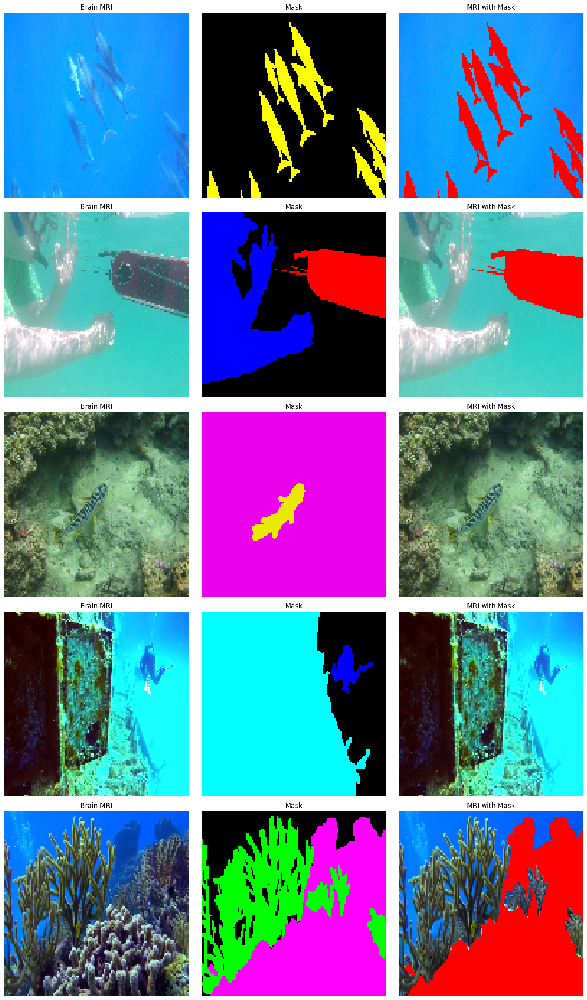

In [174]:
fig, axs = plt.subplots(5, 3, figsize=(15, 25))
for i in range(5):
	img = augment_samples[0][i]
	axs[i][0].title.set_text("Brain MRI")
	axs[i][0].axis('off')
	axs[i][0].imshow(img)
	
	mask = augment_samples[1][i]
	axs[i][1].title.set_text('Mask')
	axs[i][1].axis('off')
	axs[i][1].imshow(mask, cmap='gray')
	
	tumor_area = mask[:, :, 0] == 1.0
	img[:, :, :3][tumor_area] = [1.0, 0.0, 0.0] 
	axs[i][2].axis('off')
	axs[i][2].title.set_text('MRI with Mask')
	axs[i][2].imshow(img)

        
fig.tight_layout()
plt.show()

In [195]:
batch_size = 4
initial_learning_rate = 3e-4
num_epochs = 100
optimizer = tf.keras.optimizers.Adam(
    # learning_rate = initial_learning_rate, 
    # beta_1 = 0.9, 
    # beta_2 = 0.999, 
    # epsilon = None, 
    # decay = 1e-3/32, 
    # amsgrad = False
)
loss = 'binary_crossentropy'
metrics = [
        iou, 
        dice_coef, 
        'binary_accuracy'
    ]

In [196]:
train_gen = data_generator(
    dataframe = train,
    batch_size = batch_size,
    aug_dict = aug_methods
)

valid_gen = data_generator(
    dataframe = valid,
    batch_size = batch_size,
    aug_dict = dict()
)

In [197]:
model = aunet

In [198]:
model.compile(
    loss = loss, 
    optimizer = optimizer, 
    metrics = metrics
)

In [199]:
from keras.callbacks import Callback
class ShowSample(Callback):
	def on_epoch_end(self, epoch, logs=None):
		img, mask = read_image(test.iloc[i]['image'], test.iloc[i]['mask'])
		img = tf.reshape(img, (1, WIDTH, HEIGHT, 3))
		mask_pred = model.predict(img)

		fig, axs = plt.subplots(1, 3, figsize=(15, 5))

		axs[0].title.set_text("Pic")
		axs[0].axis('off')
		axs[0].imshow(img[0])

		axs[1].title.set_text('Mask')
		axs[1].axis('off')
		axs[1].imshow(mask)

		axs[2].title.set_text('Predicted Mask')
		axs[2].axis('off')
		axs[2].imshow(mask_pred[0], cmap='gray')

		plt.show()

Found 1372 validated image filenames.
Found 1372 validated image filenames.
Epoch 1/100
1/1 [==============================] - 0s 372ms/step loss: 0.5828 - iou: 0.4028 - dice_coef: 0.5714 - binary_accuracy: 0.56


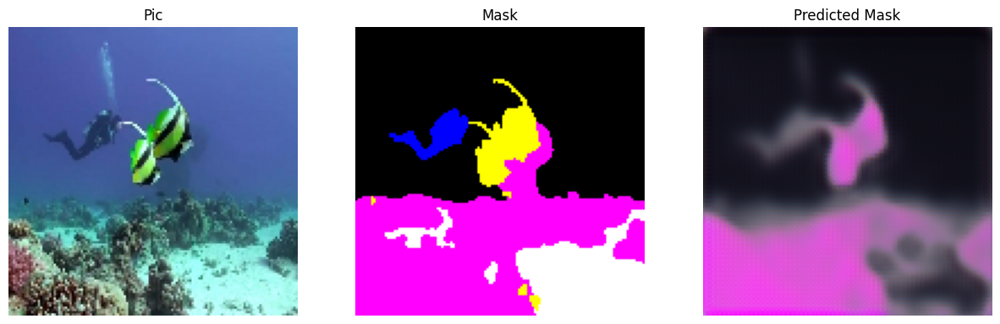

343/343 [==============================] - 47s 127ms/step - loss: 0.5828 - iou: 0.4028 - dice_coef: 0.5714 - binary_accuracy: 0.5648 - val_loss: 0.5326 - val_iou: 0.4692 - val_dice_coef: 0.6342 - val_binary_accuracy: 0.7617
Epoch 2/100
1/1 [==============================] - 0s 28ms/step- loss: 0.5809 - iou: 0.4055 - dice_coef: 0.5737 - binary_accuracy: 0.55


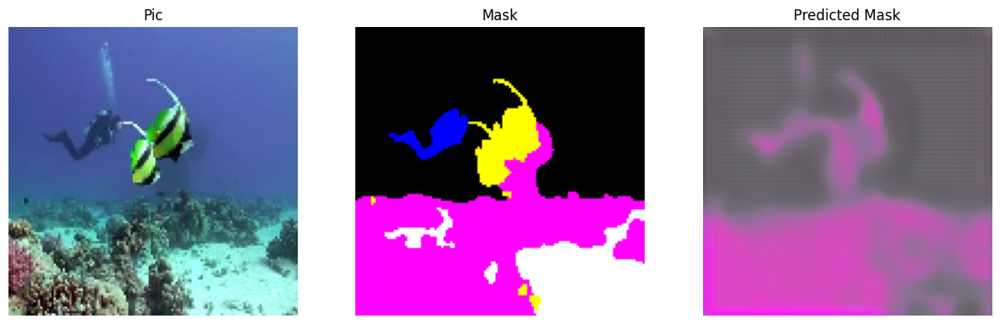

343/343 [==============================] - 43s 124ms/step - loss: 0.5809 - iou: 0.4055 - dice_coef: 0.5737 - binary_accuracy: 0.5537 - val_loss: 0.5523 - val_iou: 0.4416 - val_dice_coef: 0.6075 - val_binary_accuracy: 0.7457
Epoch 3/100
1/1 [==============================] - 0s 94ms/step- loss: 0.5634 - iou: 0.4169 - dice_coef: 0.5849 - binary_accuracy: 0.56


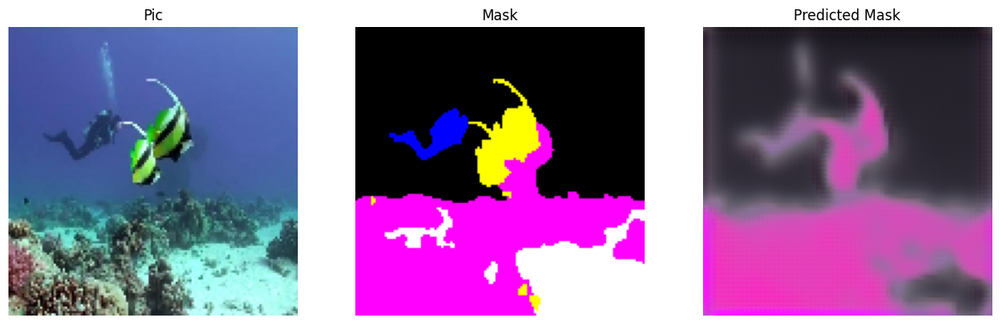

343/343 [==============================] - 43s 125ms/step - loss: 0.5634 - iou: 0.4169 - dice_coef: 0.5849 - binary_accuracy: 0.5665 - val_loss: 0.4931 - val_iou: 0.4746 - val_dice_coef: 0.6398 - val_binary_accuracy: 0.7814
Epoch 4/100
1/1 [==============================] - 0s 105ms/step loss: 0.5658 - iou: 0.4157 - dice_coef: 0.5833 - binary_accuracy: 0.57


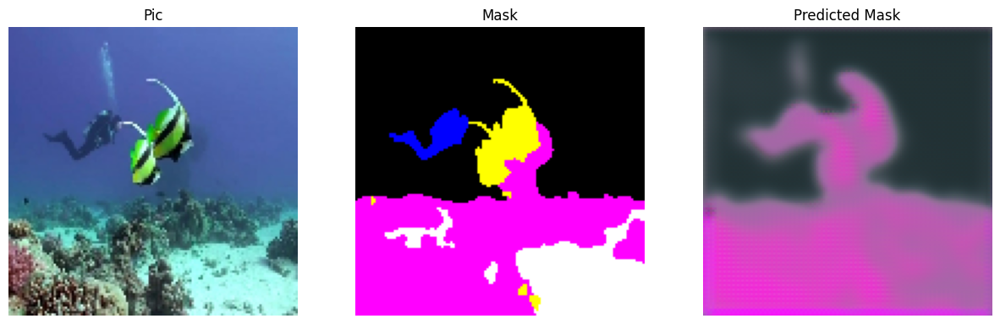

343/343 [==============================] - 43s 125ms/step - loss: 0.5658 - iou: 0.4157 - dice_coef: 0.5833 - binary_accuracy: 0.5734 - val_loss: 0.5179 - val_iou: 0.4687 - val_dice_coef: 0.6327 - val_binary_accuracy: 0.7549
Epoch 5/100
1/1 [==============================] - 0s 91ms/step- loss: 0.5566 - iou: 0.4254 - dice_coef: 0.5938 - binary_accuracy: 0.57


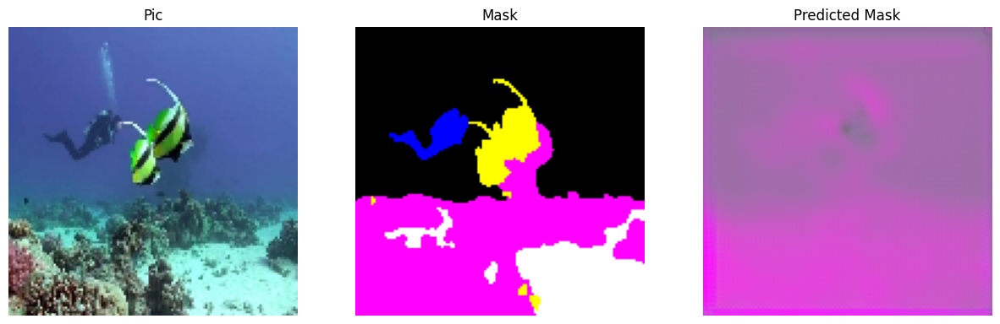

343/343 [==============================] - 43s 125ms/step - loss: 0.5566 - iou: 0.4254 - dice_coef: 0.5938 - binary_accuracy: 0.5786 - val_loss: 0.5959 - val_iou: 0.4665 - val_dice_coef: 0.6281 - val_binary_accuracy: 0.6624
Epoch 6/100
1/1 [==============================] - 0s 35ms/step- loss: 0.5515 - iou: 0.4280 - dice_coef: 0.5959 - binary_accuracy: 0.57


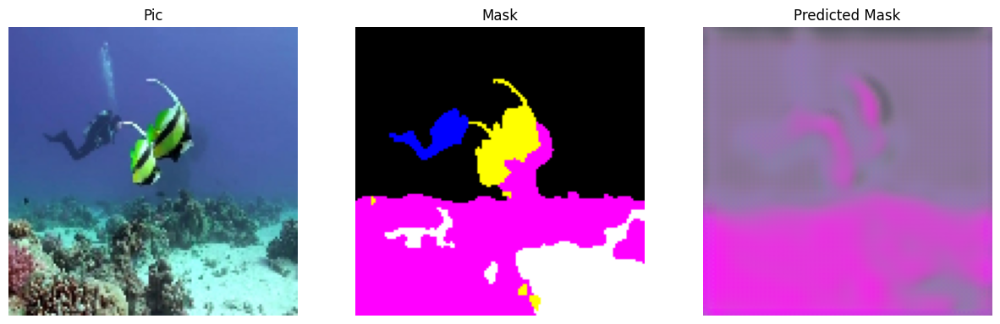

343/343 [==============================] - 43s 125ms/step - loss: 0.5515 - iou: 0.4280 - dice_coef: 0.5959 - binary_accuracy: 0.5738 - val_loss: 0.5492 - val_iou: 0.4844 - val_dice_coef: 0.6480 - val_binary_accuracy: 0.7304
Epoch 7/100
1/1 [==============================] - 0s 118ms/step loss: 0.5427 - iou: 0.4326 - dice_coef: 0.6001 - binary_accuracy: 0.56


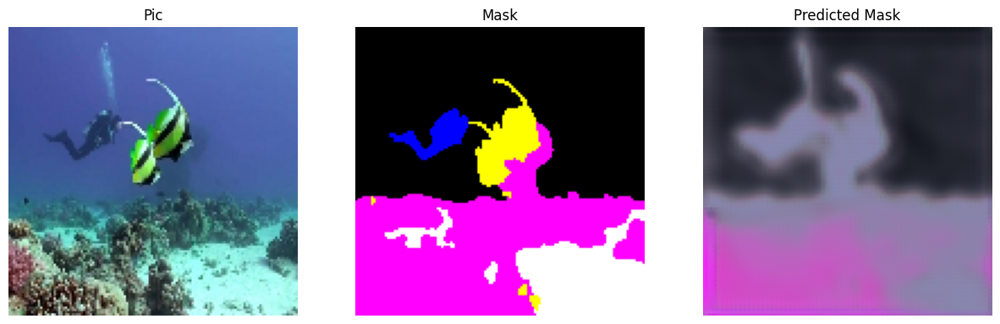

343/343 [==============================] - 43s 125ms/step - loss: 0.5427 - iou: 0.4326 - dice_coef: 0.6001 - binary_accuracy: 0.5652 - val_loss: 0.5381 - val_iou: 0.4425 - val_dice_coef: 0.6088 - val_binary_accuracy: 0.7182
Epoch 8/100
1/1 [==============================] - 0s 104ms/step loss: 0.5326 - iou: 0.4459 - dice_coef: 0.6136 - binary_accuracy: 0.58


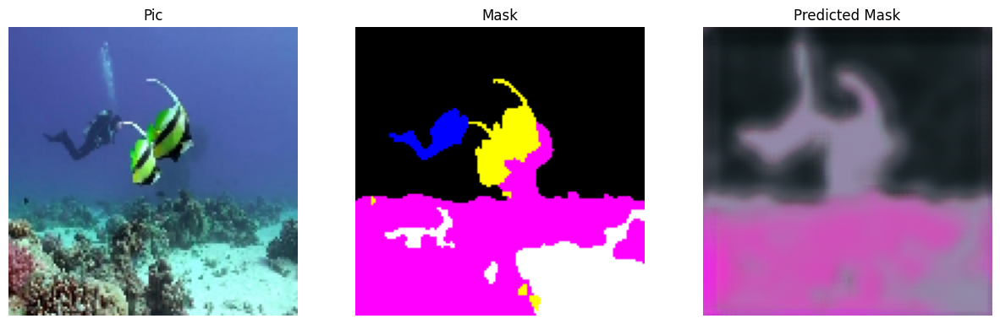

343/343 [==============================] - 43s 125ms/step - loss: 0.5326 - iou: 0.4459 - dice_coef: 0.6136 - binary_accuracy: 0.5833 - val_loss: 0.4959 - val_iou: 0.4774 - val_dice_coef: 0.6419 - val_binary_accuracy: 0.7527
Epoch 9/100
1/1 [==============================] - 0s 32ms/step- loss: 0.5313 - iou: 0.4436 - dice_coef: 0.6107 - binary_accuracy: 0.57


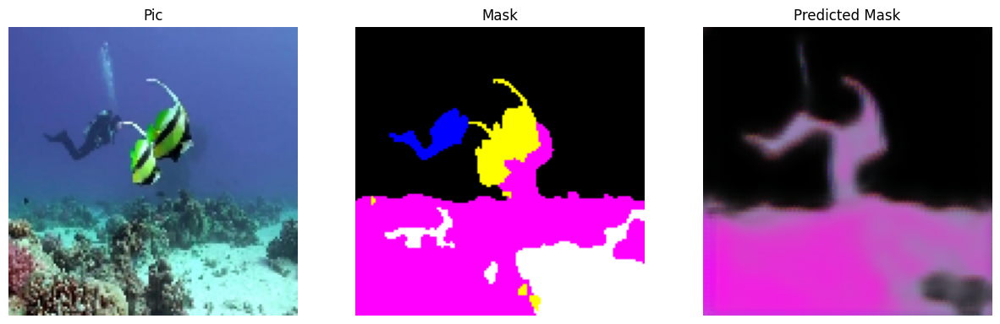

343/343 [==============================] - 43s 125ms/step - loss: 0.5313 - iou: 0.4436 - dice_coef: 0.6107 - binary_accuracy: 0.5784 - val_loss: 0.5100 - val_iou: 0.5272 - val_dice_coef: 0.6866 - val_binary_accuracy: 0.7834
Epoch 10/100
1/1 [==============================] - 0s 28ms/step- loss: 0.5278 - iou: 0.4515 - dice_coef: 0.6182 - binary_accuracy: 0.58


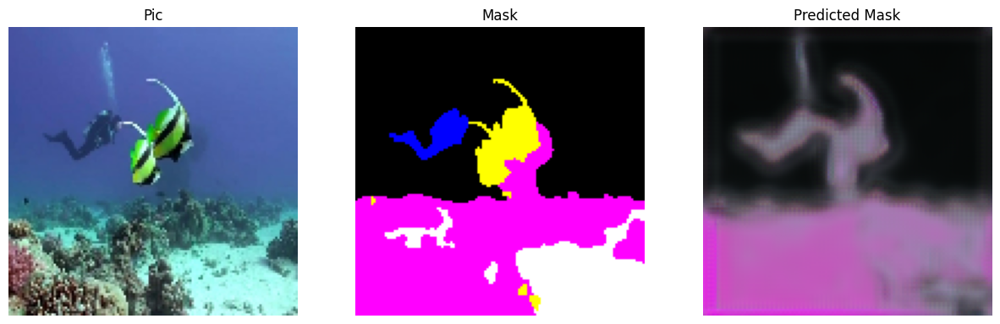

343/343 [==============================] - 43s 125ms/step - loss: 0.5278 - iou: 0.4515 - dice_coef: 0.6182 - binary_accuracy: 0.5801 - val_loss: 0.4753 - val_iou: 0.4456 - val_dice_coef: 0.6122 - val_binary_accuracy: 0.7733
Epoch 11/100
1/1 [==============================] - 0s 24ms/step- loss: 0.5238 - iou: 0.4516 - dice_coef: 0.6187 - binary_accuracy: 0.57


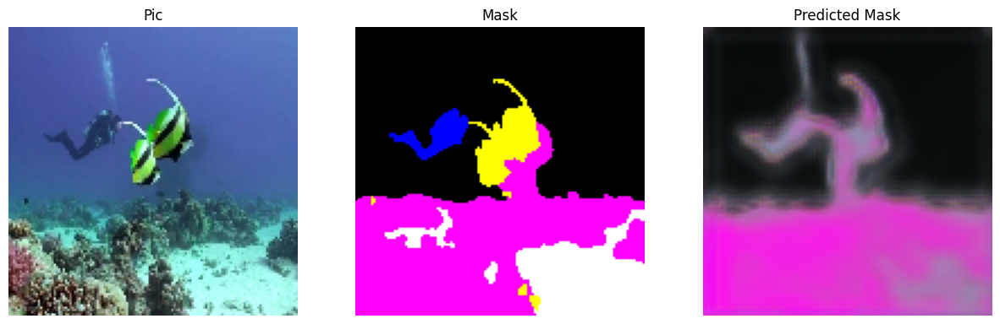

343/343 [==============================] - 43s 125ms/step - loss: 0.5238 - iou: 0.4516 - dice_coef: 0.6187 - binary_accuracy: 0.5762 - val_loss: 0.4933 - val_iou: 0.5305 - val_dice_coef: 0.6880 - val_binary_accuracy: 0.7546
Epoch 12/100
1/1 [==============================] - 0s 59ms/step- loss: 0.5195 - iou: 0.4571 - dice_coef: 0.6236 - binary_accuracy: 0.57


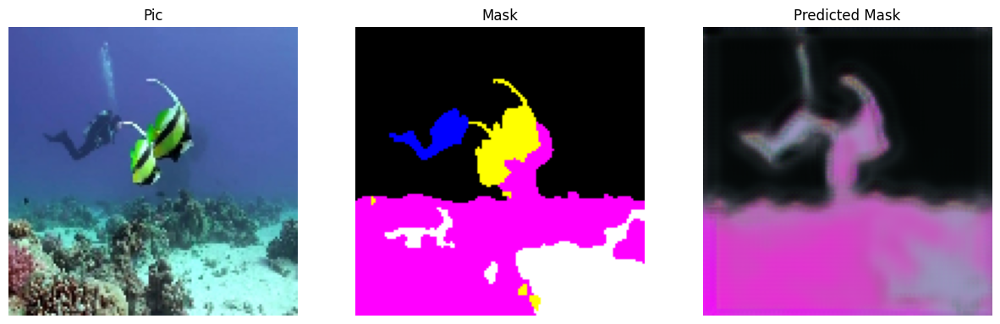

343/343 [==============================] - 43s 125ms/step - loss: 0.5195 - iou: 0.4571 - dice_coef: 0.6236 - binary_accuracy: 0.5796 - val_loss: 0.4659 - val_iou: 0.5097 - val_dice_coef: 0.6697 - val_binary_accuracy: 0.7805
Epoch 13/100
1/1 [==============================] - 0s 25ms/step- loss: 0.5148 - iou: 0.4590 - dice_coef: 0.6254 - binary_accuracy: 0.58


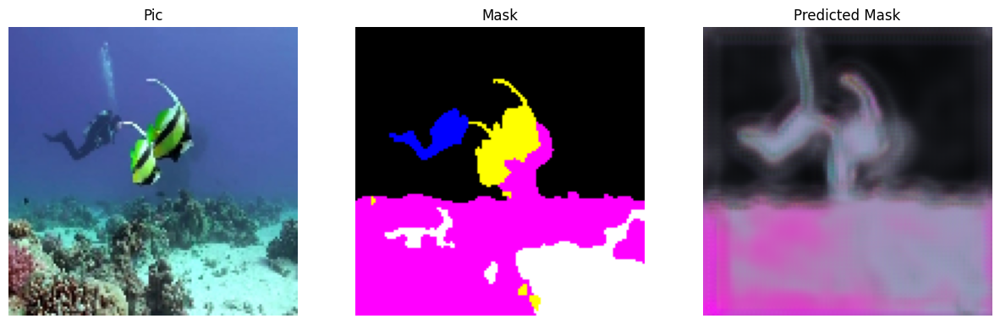

343/343 [==============================] - 43s 125ms/step - loss: 0.5148 - iou: 0.4590 - dice_coef: 0.6254 - binary_accuracy: 0.5823 - val_loss: 0.4981 - val_iou: 0.4558 - val_dice_coef: 0.6221 - val_binary_accuracy: 0.7469
Epoch 14/100
1/1 [==============================] - 0s 24ms/step- loss: 0.5125 - iou: 0.4636 - dice_coef: 0.6296 - binary_accuracy: 0.58


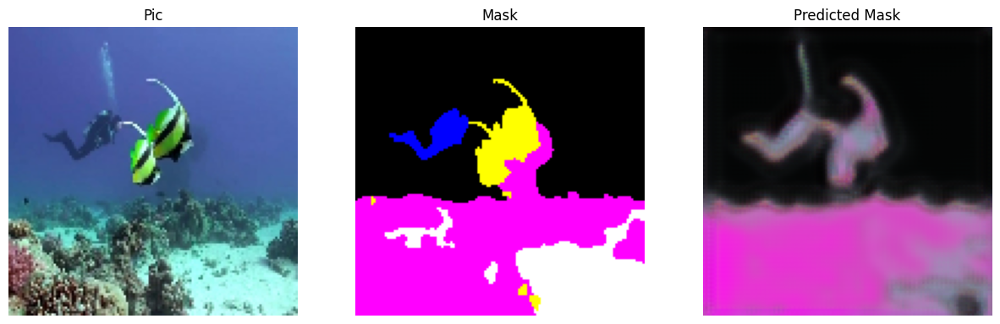

343/343 [==============================] - 43s 125ms/step - loss: 0.5125 - iou: 0.4636 - dice_coef: 0.6296 - binary_accuracy: 0.5871 - val_loss: 0.4722 - val_iou: 0.5058 - val_dice_coef: 0.6666 - val_binary_accuracy: 0.7650
Epoch 15/100
1/1 [==============================] - 0s 66ms/step- loss: 0.5106 - iou: 0.4637 - dice_coef: 0.6297 - binary_accuracy: 0.57


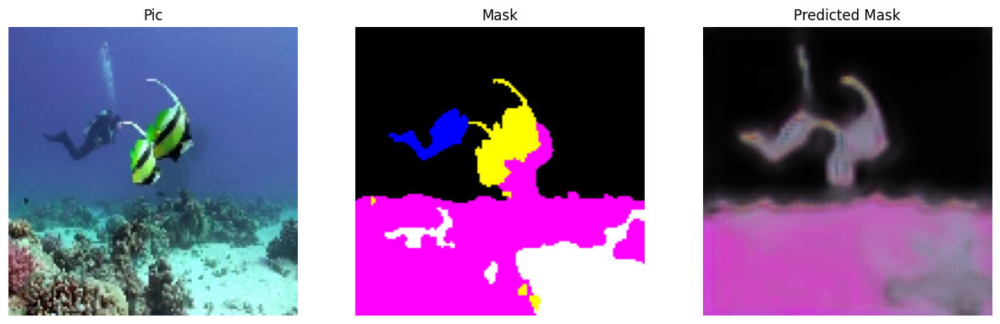

343/343 [==============================] - 43s 125ms/step - loss: 0.5106 - iou: 0.4637 - dice_coef: 0.6297 - binary_accuracy: 0.5729 - val_loss: 0.4754 - val_iou: 0.4744 - val_dice_coef: 0.6382 - val_binary_accuracy: 0.7868
Epoch 16/100
1/1 [==============================] - 0s 24ms/step- loss: 0.5050 - iou: 0.4678 - dice_coef: 0.6336 - binary_accuracy: 0.58


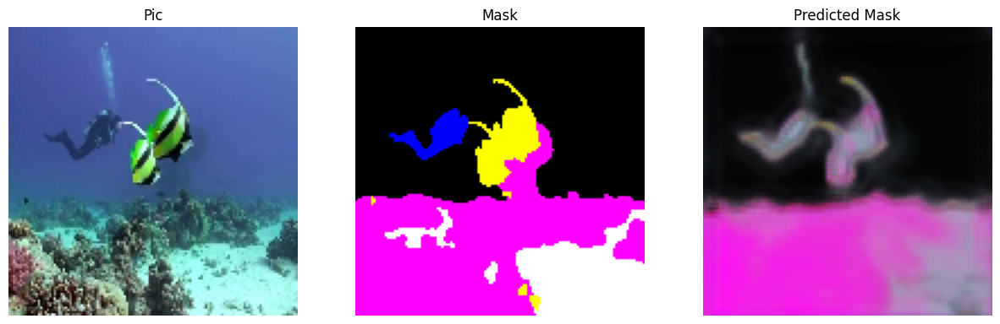

343/343 [==============================] - 43s 125ms/step - loss: 0.5050 - iou: 0.4678 - dice_coef: 0.6336 - binary_accuracy: 0.5862 - val_loss: 0.4702 - val_iou: 0.5238 - val_dice_coef: 0.6819 - val_binary_accuracy: 0.7600
Epoch 17/100
1/1 [==============================] - 0s 23ms/step- loss: 0.5052 - iou: 0.4695 - dice_coef: 0.6356 - binary_accuracy: 0.58


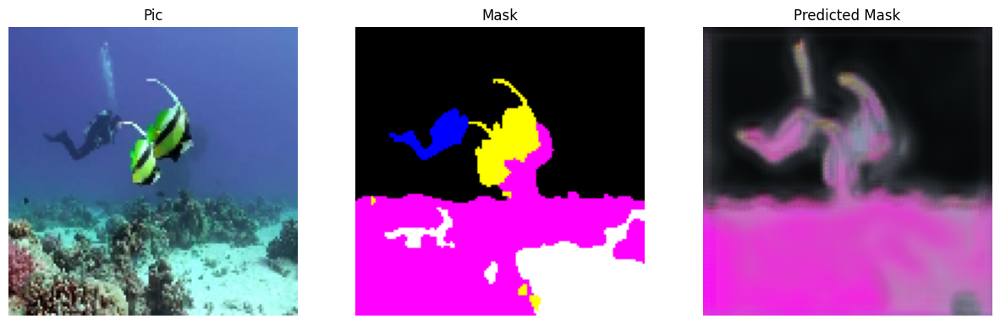

343/343 [==============================] - 43s 125ms/step - loss: 0.5052 - iou: 0.4695 - dice_coef: 0.6356 - binary_accuracy: 0.5807 - val_loss: 0.4173 - val_iou: 0.5570 - val_dice_coef: 0.7118 - val_binary_accuracy: 0.8070
Epoch 18/100
1/1 [==============================] - 0s 32ms/step- loss: 0.5015 - iou: 0.4722 - dice_coef: 0.6379 - binary_accuracy: 0.58


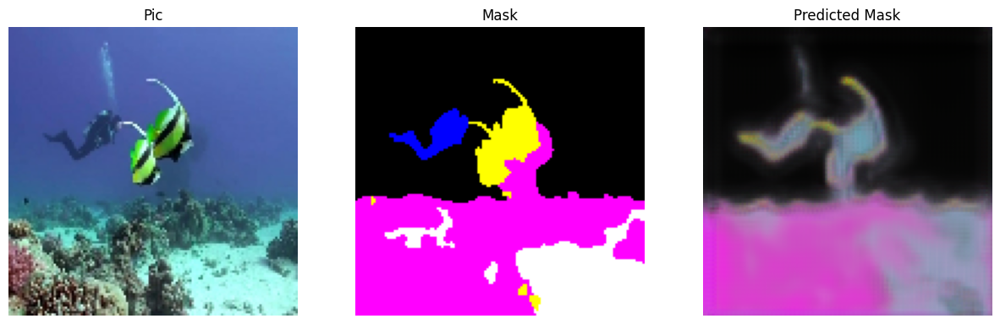

343/343 [==============================] - 43s 125ms/step - loss: 0.5015 - iou: 0.4722 - dice_coef: 0.6379 - binary_accuracy: 0.5875 - val_loss: 0.4802 - val_iou: 0.4930 - val_dice_coef: 0.6565 - val_binary_accuracy: 0.7671
Epoch 19/100
1/1 [==============================] - 0s 30ms/step- loss: 0.4966 - iou: 0.4749 - dice_coef: 0.6404 - binary_accuracy: 0.57


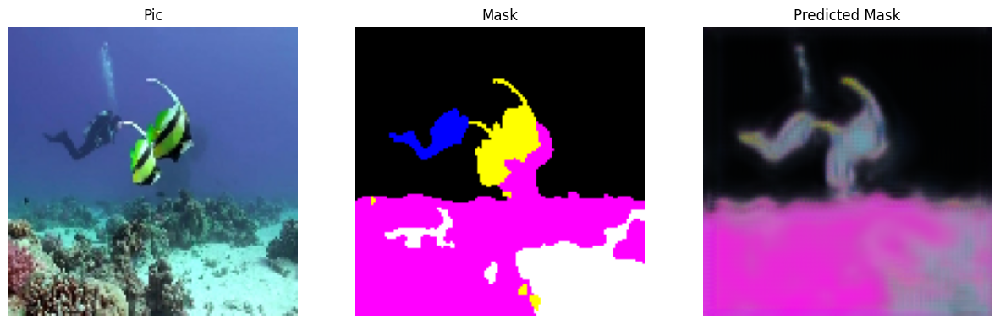

343/343 [==============================] - 43s 125ms/step - loss: 0.4966 - iou: 0.4749 - dice_coef: 0.6404 - binary_accuracy: 0.5754 - val_loss: 0.4663 - val_iou: 0.5197 - val_dice_coef: 0.6812 - val_binary_accuracy: 0.7782
Epoch 20/100
1/1 [==============================] - 0s 35ms/step- loss: 0.4980 - iou: 0.4745 - dice_coef: 0.6392 - binary_accuracy: 0.59


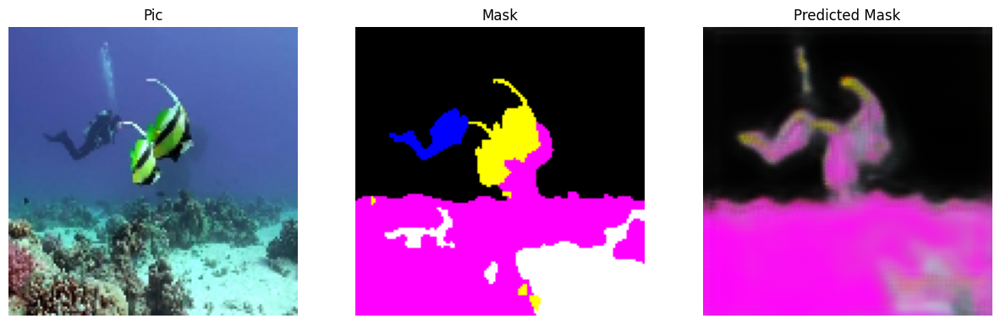

343/343 [==============================] - 43s 126ms/step - loss: 0.4980 - iou: 0.4745 - dice_coef: 0.6392 - binary_accuracy: 0.5923 - val_loss: 0.4667 - val_iou: 0.5906 - val_dice_coef: 0.7360 - val_binary_accuracy: 0.7849
Epoch 21/100
1/1 [==============================] - 0s 28ms/step- loss: 0.4940 - iou: 0.4787 - dice_coef: 0.6428 - binary_accuracy: 0.59


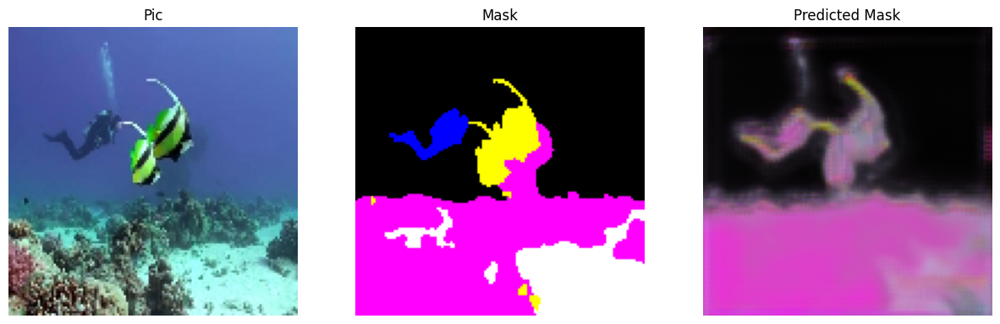

343/343 [==============================] - 43s 125ms/step - loss: 0.4940 - iou: 0.4787 - dice_coef: 0.6428 - binary_accuracy: 0.5955 - val_loss: 0.4320 - val_iou: 0.5147 - val_dice_coef: 0.6760 - val_binary_accuracy: 0.8076
Epoch 22/100
1/1 [==============================] - 0s 70ms/step- loss: 0.4892 - iou: 0.4833 - dice_coef: 0.6477 - binary_accuracy: 0.60


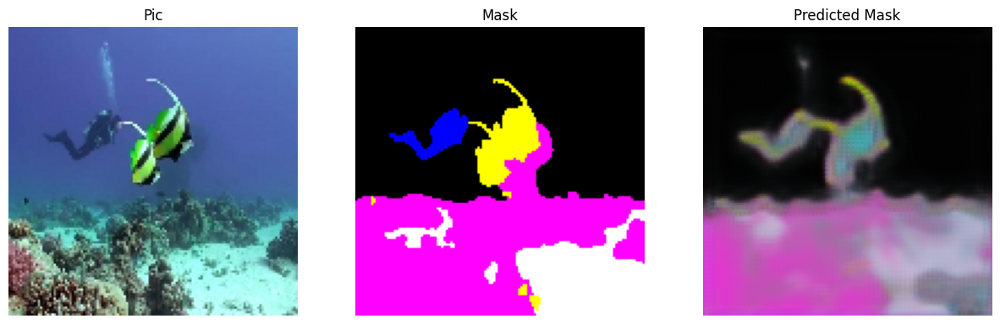

343/343 [==============================] - 43s 126ms/step - loss: 0.4892 - iou: 0.4833 - dice_coef: 0.6477 - binary_accuracy: 0.6022 - val_loss: 0.5068 - val_iou: 0.4712 - val_dice_coef: 0.6356 - val_binary_accuracy: 0.7712
Epoch 23/100
1/1 [==============================] - 0s 21ms/step- loss: 0.4822 - iou: 0.4883 - dice_coef: 0.6523 - binary_accuracy: 0.59


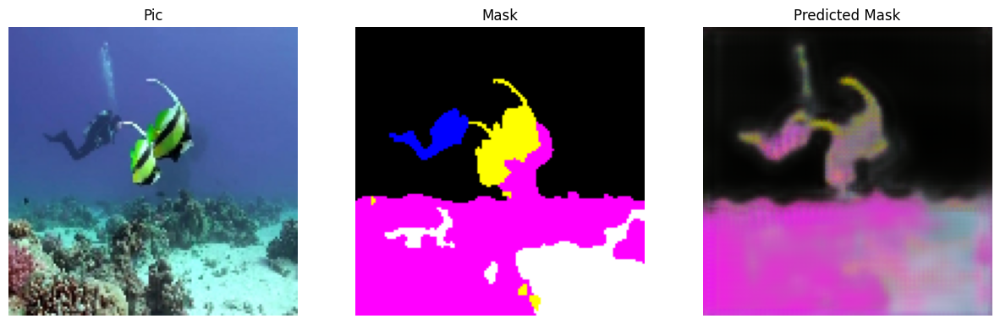

343/343 [==============================] - 44s 129ms/step - loss: 0.4822 - iou: 0.4883 - dice_coef: 0.6523 - binary_accuracy: 0.5968 - val_loss: 0.4570 - val_iou: 0.5216 - val_dice_coef: 0.6830 - val_binary_accuracy: 0.7775
Epoch 24/100
1/1 [==============================] - 0s 25ms/step- loss: 0.4867 - iou: 0.4855 - dice_coef: 0.6501 - binary_accuracy: 0.58


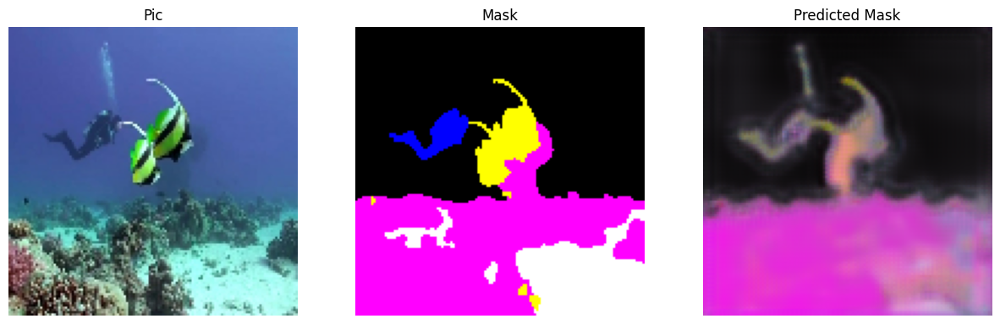

343/343 [==============================] - 43s 125ms/step - loss: 0.4867 - iou: 0.4855 - dice_coef: 0.6501 - binary_accuracy: 0.5893 - val_loss: 0.4465 - val_iou: 0.5215 - val_dice_coef: 0.6815 - val_binary_accuracy: 0.7889
Epoch 25/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4765 - iou: 0.4936 - dice_coef: 0.6568 - binary_accuracy: 0.60


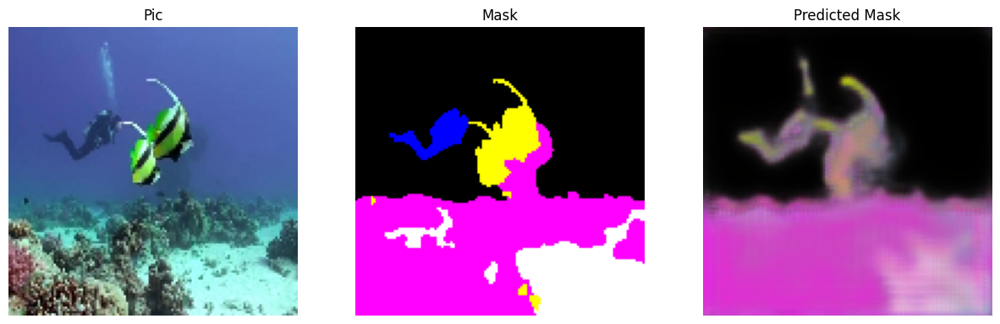

343/343 [==============================] - 43s 125ms/step - loss: 0.4765 - iou: 0.4936 - dice_coef: 0.6568 - binary_accuracy: 0.6022 - val_loss: 0.4375 - val_iou: 0.5287 - val_dice_coef: 0.6886 - val_binary_accuracy: 0.8032
Epoch 26/100
1/1 [==============================] - 0s 25ms/step- loss: 0.4974 - iou: 0.4744 - dice_coef: 0.6393 - binary_accuracy: 0.59


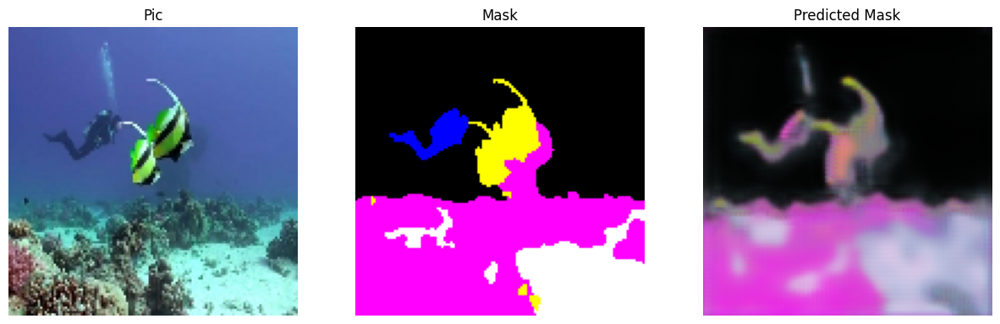

343/343 [==============================] - 43s 125ms/step - loss: 0.4974 - iou: 0.4744 - dice_coef: 0.6393 - binary_accuracy: 0.5938 - val_loss: 0.4563 - val_iou: 0.5309 - val_dice_coef: 0.6882 - val_binary_accuracy: 0.7808
Epoch 27/100
1/1 [==============================] - 0s 24ms/step- loss: 0.4729 - iou: 0.4971 - dice_coef: 0.6600 - binary_accuracy: 0.60


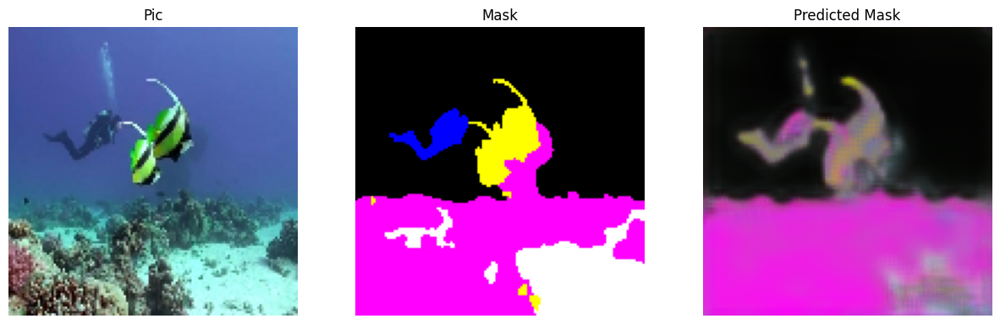

343/343 [==============================] - 43s 125ms/step - loss: 0.4729 - iou: 0.4971 - dice_coef: 0.6600 - binary_accuracy: 0.6097 - val_loss: 0.4174 - val_iou: 0.5577 - val_dice_coef: 0.7118 - val_binary_accuracy: 0.8053
Epoch 28/100
1/1 [==============================] - 0s 24ms/step- loss: 0.4752 - iou: 0.4967 - dice_coef: 0.6604 - binary_accuracy: 0.60


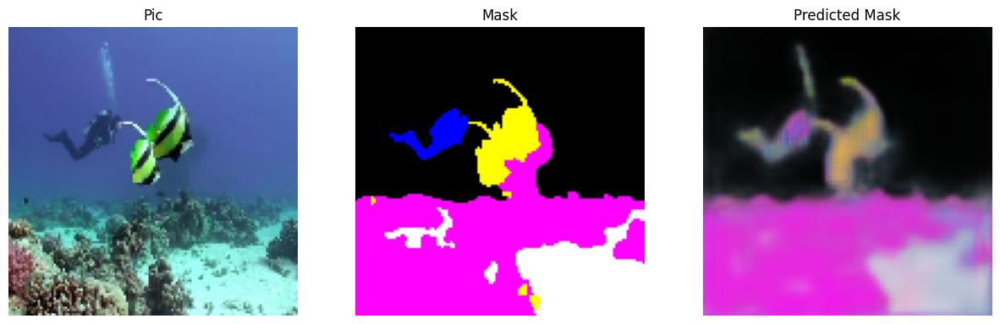

343/343 [==============================] - 43s 125ms/step - loss: 0.4752 - iou: 0.4967 - dice_coef: 0.6604 - binary_accuracy: 0.6010 - val_loss: 0.4399 - val_iou: 0.5460 - val_dice_coef: 0.7012 - val_binary_accuracy: 0.7906
Epoch 29/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4687 - iou: 0.5013 - dice_coef: 0.6642 - binary_accuracy: 0.61


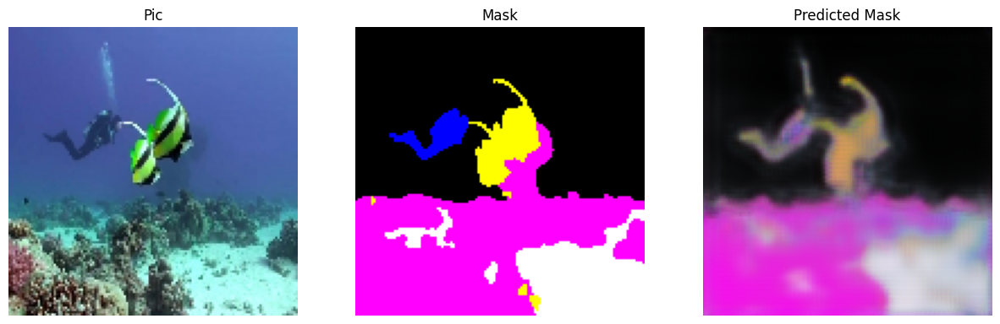

343/343 [==============================] - 43s 125ms/step - loss: 0.4687 - iou: 0.5013 - dice_coef: 0.6642 - binary_accuracy: 0.6105 - val_loss: 0.4523 - val_iou: 0.5407 - val_dice_coef: 0.6987 - val_binary_accuracy: 0.7811
Epoch 30/100
1/1 [==============================] - 0s 69ms/step- loss: 0.4666 - iou: 0.5029 - dice_coef: 0.6648 - binary_accuracy: 0.61


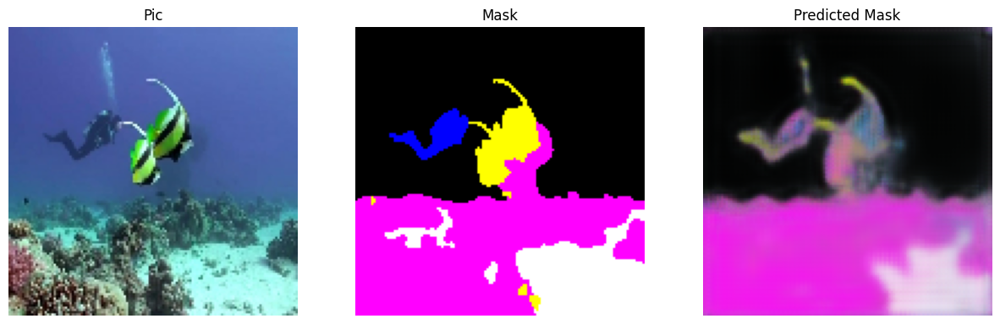

343/343 [==============================] - 43s 125ms/step - loss: 0.4666 - iou: 0.5029 - dice_coef: 0.6648 - binary_accuracy: 0.6108 - val_loss: 0.4178 - val_iou: 0.5752 - val_dice_coef: 0.7269 - val_binary_accuracy: 0.8048
Epoch 31/100
1/1 [==============================] - 0s 64ms/step- loss: 0.4661 - iou: 0.5039 - dice_coef: 0.6667 - binary_accuracy: 0.59


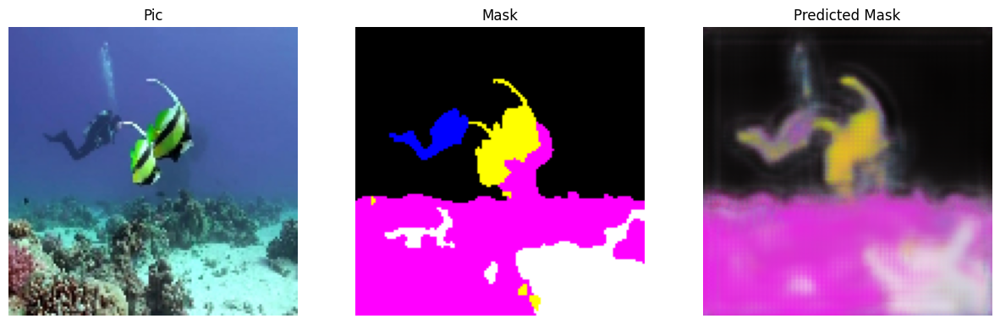

343/343 [==============================] - 43s 125ms/step - loss: 0.4661 - iou: 0.5039 - dice_coef: 0.6667 - binary_accuracy: 0.5943 - val_loss: 0.4526 - val_iou: 0.5234 - val_dice_coef: 0.6836 - val_binary_accuracy: 0.7802
Epoch 32/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4715 - iou: 0.5004 - dice_coef: 0.6633 - binary_accuracy: 0.60


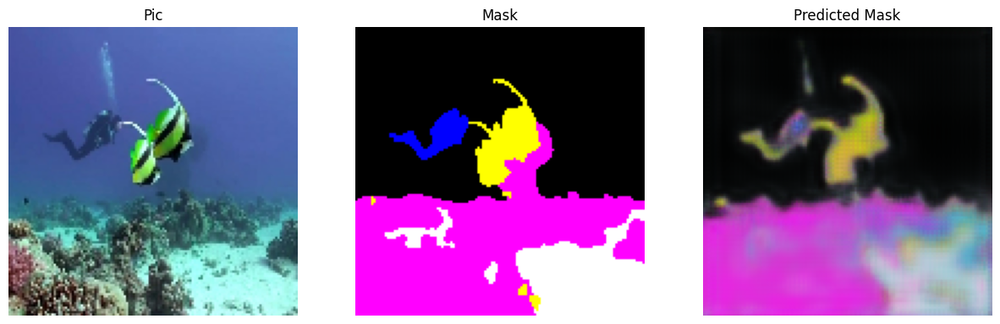

343/343 [==============================] - 43s 125ms/step - loss: 0.4715 - iou: 0.5004 - dice_coef: 0.6633 - binary_accuracy: 0.6070 - val_loss: 0.4571 - val_iou: 0.5111 - val_dice_coef: 0.6727 - val_binary_accuracy: 0.7860
Epoch 33/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4664 - iou: 0.5022 - dice_coef: 0.6649 - binary_accuracy: 0.59


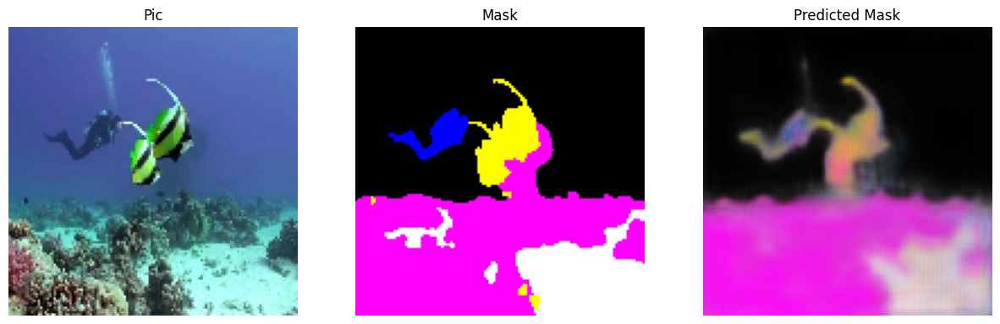

343/343 [==============================] - 43s 124ms/step - loss: 0.4664 - iou: 0.5022 - dice_coef: 0.6649 - binary_accuracy: 0.5963 - val_loss: 0.4226 - val_iou: 0.5805 - val_dice_coef: 0.7277 - val_binary_accuracy: 0.7971
Epoch 34/100
1/1 [==============================] - 0s 21ms/step- loss: 0.4673 - iou: 0.5031 - dice_coef: 0.6654 - binary_accuracy: 0.60


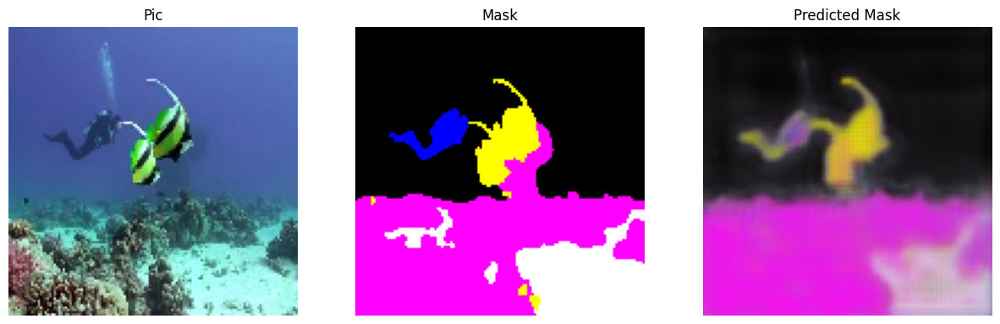

343/343 [==============================] - 43s 125ms/step - loss: 0.4673 - iou: 0.5031 - dice_coef: 0.6654 - binary_accuracy: 0.6067 - val_loss: 0.4399 - val_iou: 0.5267 - val_dice_coef: 0.6837 - val_binary_accuracy: 0.7921
Epoch 35/100
1/1 [==============================] - 0s 20ms/step- loss: 0.4608 - iou: 0.5082 - dice_coef: 0.6703 - binary_accuracy: 0.60


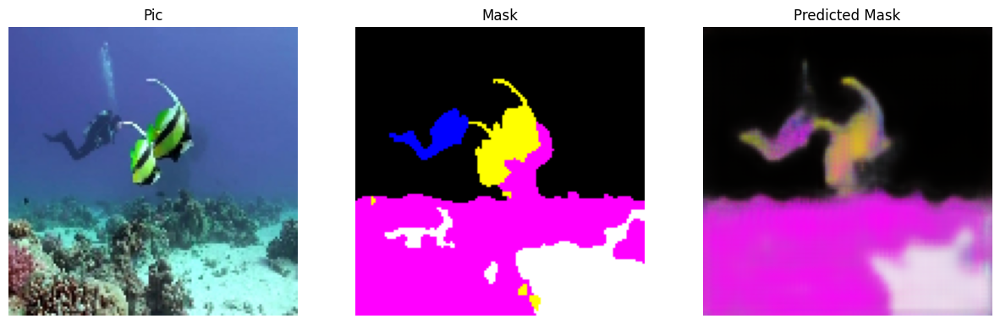

343/343 [==============================] - 43s 125ms/step - loss: 0.4608 - iou: 0.5082 - dice_coef: 0.6703 - binary_accuracy: 0.6040 - val_loss: 0.3938 - val_iou: 0.6040 - val_dice_coef: 0.7495 - val_binary_accuracy: 0.8242
Epoch 36/100
1/1 [==============================] - 0s 23ms/step- loss: 0.4639 - iou: 0.5055 - dice_coef: 0.6677 - binary_accuracy: 0.60


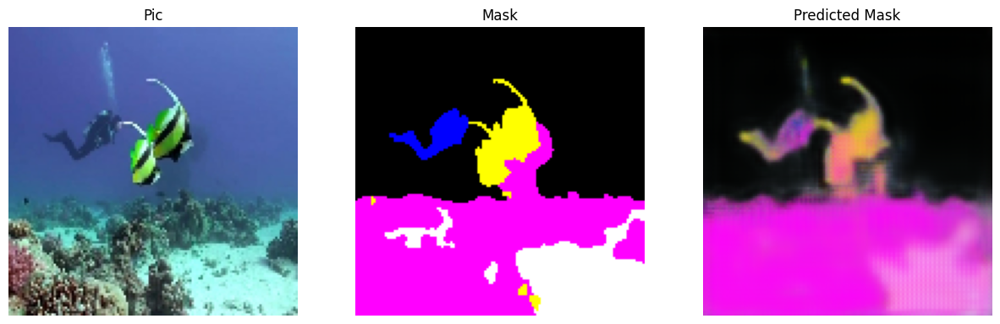

343/343 [==============================] - 43s 125ms/step - loss: 0.4639 - iou: 0.5055 - dice_coef: 0.6677 - binary_accuracy: 0.6008 - val_loss: 0.4254 - val_iou: 0.5995 - val_dice_coef: 0.7430 - val_binary_accuracy: 0.7983
Epoch 37/100
1/1 [==============================] - 0s 21ms/step- loss: 0.4571 - iou: 0.5119 - dice_coef: 0.6731 - binary_accuracy: 0.61


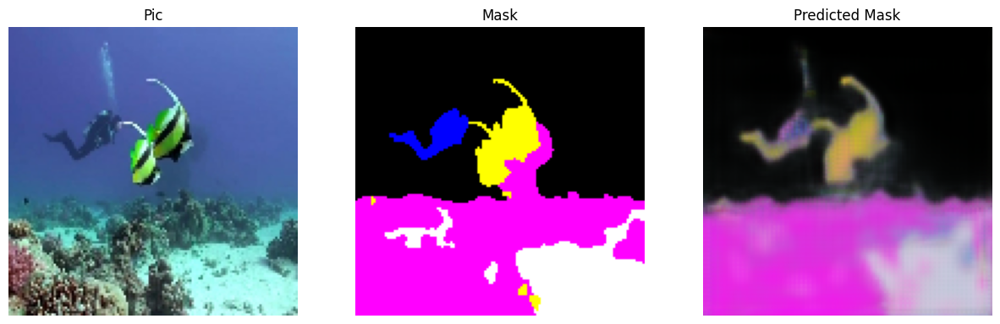

343/343 [==============================] - 43s 125ms/step - loss: 0.4571 - iou: 0.5119 - dice_coef: 0.6731 - binary_accuracy: 0.6110 - val_loss: 0.4274 - val_iou: 0.5401 - val_dice_coef: 0.6889 - val_binary_accuracy: 0.7890
Epoch 38/100
1/1 [==============================] - 0s 21ms/step- loss: 0.4569 - iou: 0.5121 - dice_coef: 0.6739 - binary_accuracy: 0.60


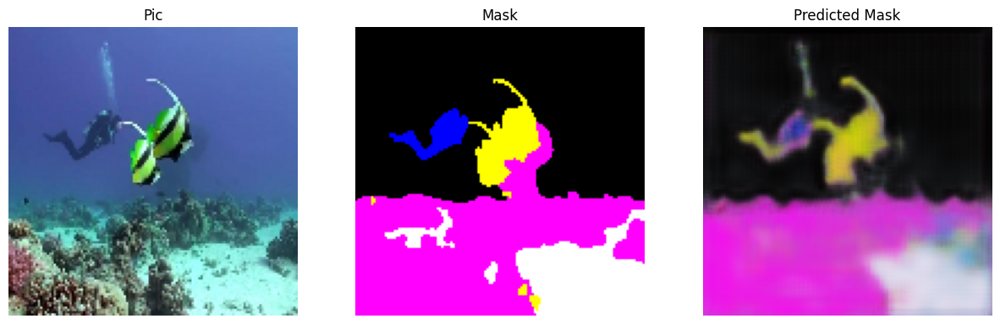

343/343 [==============================] - 43s 125ms/step - loss: 0.4569 - iou: 0.5121 - dice_coef: 0.6739 - binary_accuracy: 0.6011 - val_loss: 0.4047 - val_iou: 0.5495 - val_dice_coef: 0.7064 - val_binary_accuracy: 0.8187
Epoch 39/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4515 - iou: 0.5144 - dice_coef: 0.6751 - binary_accuracy: 0.60


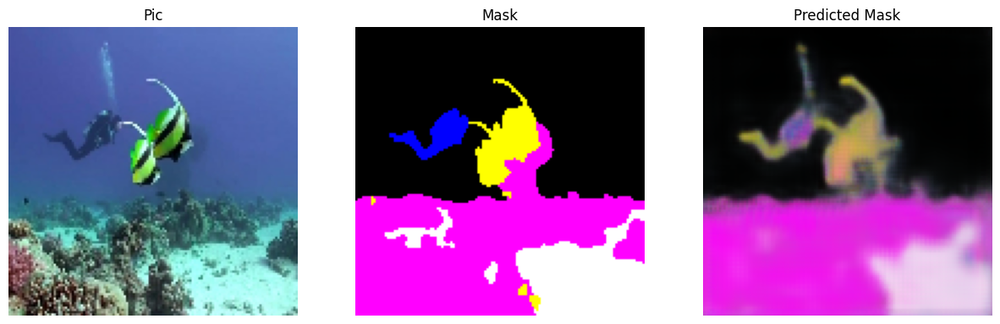

343/343 [==============================] - 43s 125ms/step - loss: 0.4515 - iou: 0.5144 - dice_coef: 0.6751 - binary_accuracy: 0.6070 - val_loss: 0.4230 - val_iou: 0.5756 - val_dice_coef: 0.7258 - val_binary_accuracy: 0.7973
Epoch 40/100
1/1 [==============================] - 0s 21ms/step- loss: 0.4469 - iou: 0.5202 - dice_coef: 0.6803 - binary_accuracy: 0.61


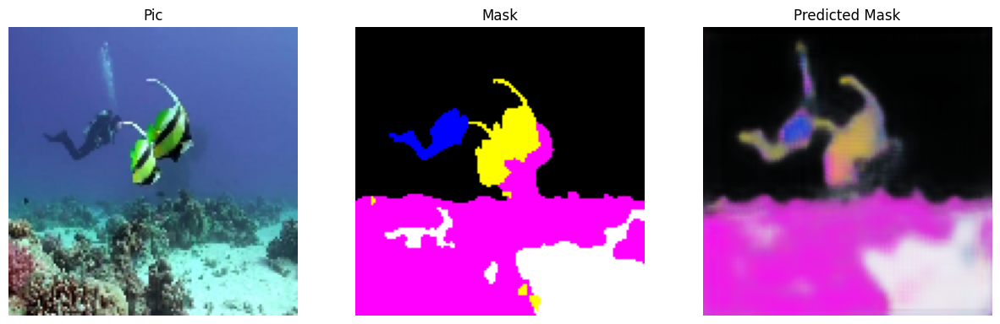

343/343 [==============================] - 43s 127ms/step - loss: 0.4469 - iou: 0.5202 - dice_coef: 0.6803 - binary_accuracy: 0.6122 - val_loss: 0.4326 - val_iou: 0.5702 - val_dice_coef: 0.7230 - val_binary_accuracy: 0.7957
Epoch 41/100
1/1 [==============================] - 0s 23ms/step- loss: 0.4499 - iou: 0.5176 - dice_coef: 0.6785 - binary_accuracy: 0.59


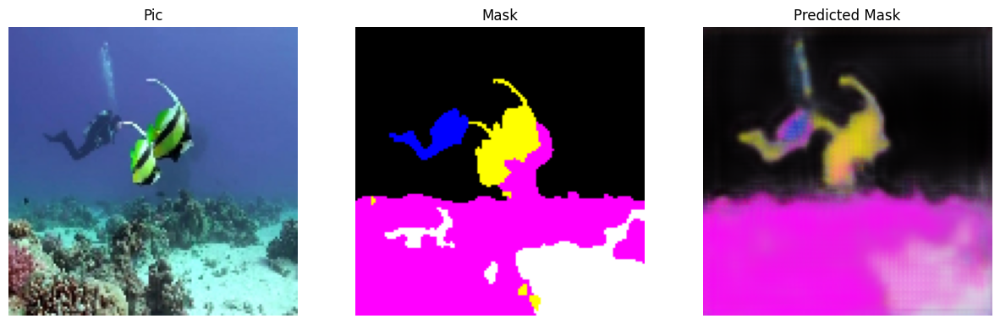

343/343 [==============================] - 43s 127ms/step - loss: 0.4499 - iou: 0.5176 - dice_coef: 0.6785 - binary_accuracy: 0.5967 - val_loss: 0.4185 - val_iou: 0.5638 - val_dice_coef: 0.7064 - val_binary_accuracy: 0.8018
Epoch 42/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4470 - iou: 0.5217 - dice_coef: 0.6821 - binary_accuracy: 0.61


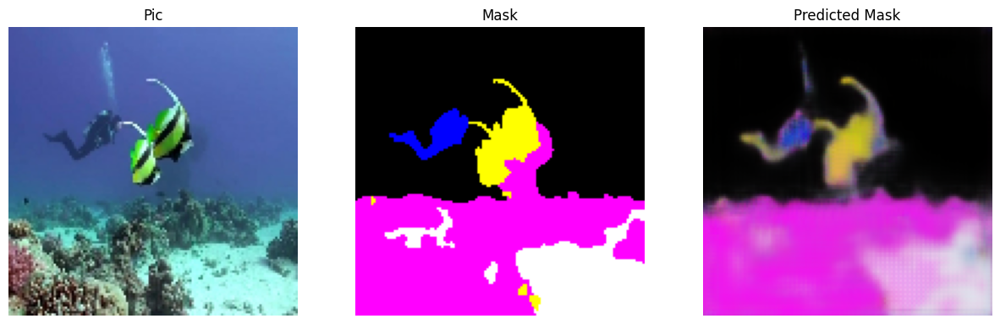

343/343 [==============================] - 44s 128ms/step - loss: 0.4470 - iou: 0.5217 - dice_coef: 0.6821 - binary_accuracy: 0.6156 - val_loss: 0.4034 - val_iou: 0.5793 - val_dice_coef: 0.7295 - val_binary_accuracy: 0.8162
Epoch 43/100
1/1 [==============================] - 0s 31ms/step- loss: 0.4447 - iou: 0.5243 - dice_coef: 0.6845 - binary_accuracy: 0.60


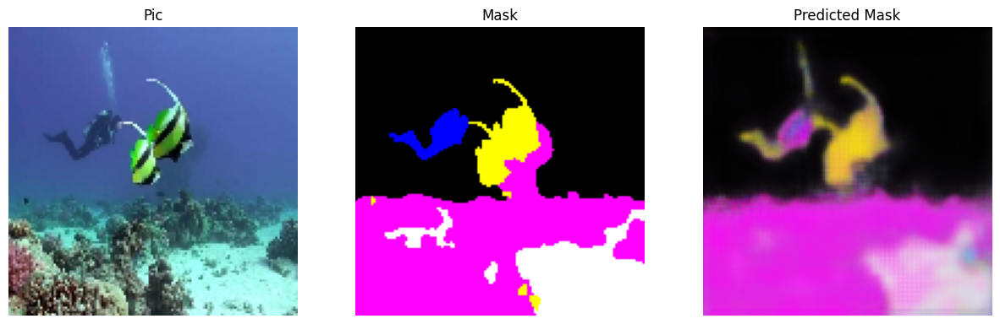

343/343 [==============================] - 44s 128ms/step - loss: 0.4447 - iou: 0.5243 - dice_coef: 0.6845 - binary_accuracy: 0.6076 - val_loss: 0.4163 - val_iou: 0.5666 - val_dice_coef: 0.7193 - val_binary_accuracy: 0.8005
Epoch 44/100
1/1 [==============================] - 0s 21ms/step- loss: 0.4436 - iou: 0.5237 - dice_coef: 0.6833 - binary_accuracy: 0.61


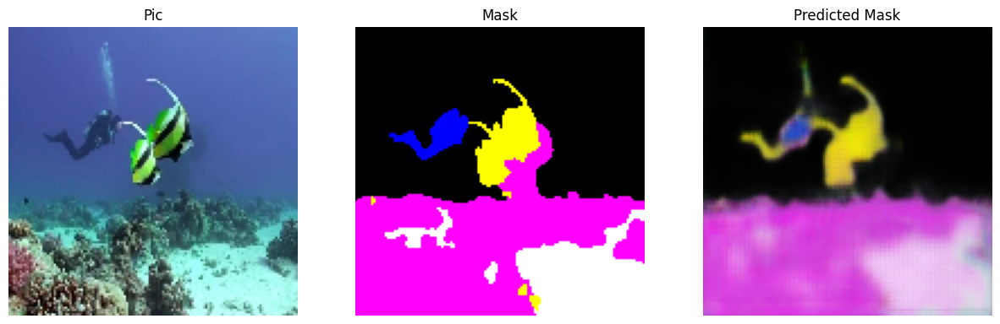

343/343 [==============================] - 43s 126ms/step - loss: 0.4436 - iou: 0.5237 - dice_coef: 0.6833 - binary_accuracy: 0.6115 - val_loss: 0.4176 - val_iou: 0.5507 - val_dice_coef: 0.7055 - val_binary_accuracy: 0.8087
Epoch 45/100
1/1 [==============================] - 0s 21ms/step- loss: 0.4380 - iou: 0.5287 - dice_coef: 0.6881 - binary_accuracy: 0.60


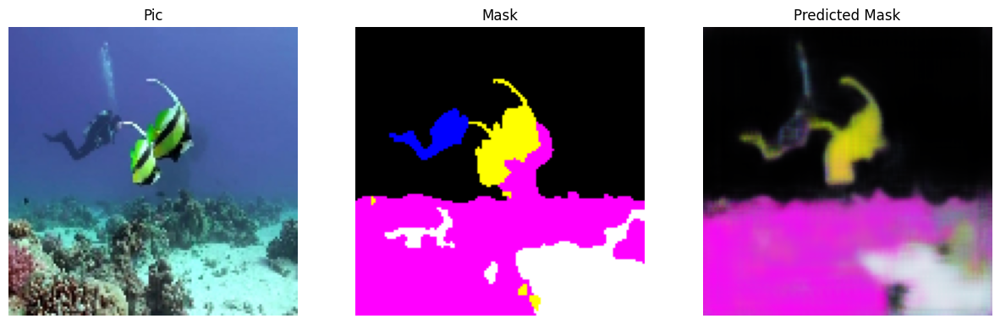

343/343 [==============================] - 43s 125ms/step - loss: 0.4380 - iou: 0.5287 - dice_coef: 0.6881 - binary_accuracy: 0.6089 - val_loss: 0.4473 - val_iou: 0.5211 - val_dice_coef: 0.6825 - val_binary_accuracy: 0.7792
Epoch 46/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4417 - iou: 0.5268 - dice_coef: 0.6863 - binary_accuracy: 0.61


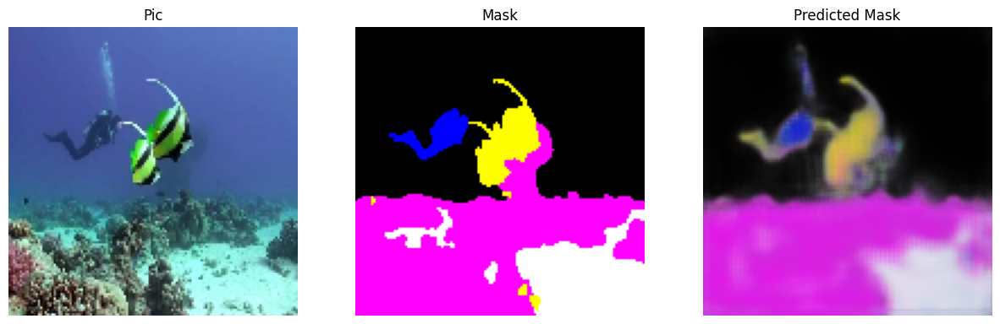

343/343 [==============================] - 43s 126ms/step - loss: 0.4417 - iou: 0.5268 - dice_coef: 0.6863 - binary_accuracy: 0.6110 - val_loss: 0.3905 - val_iou: 0.5833 - val_dice_coef: 0.7350 - val_binary_accuracy: 0.8292
Epoch 47/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4353 - iou: 0.5349 - dice_coef: 0.6939 - binary_accuracy: 0.62


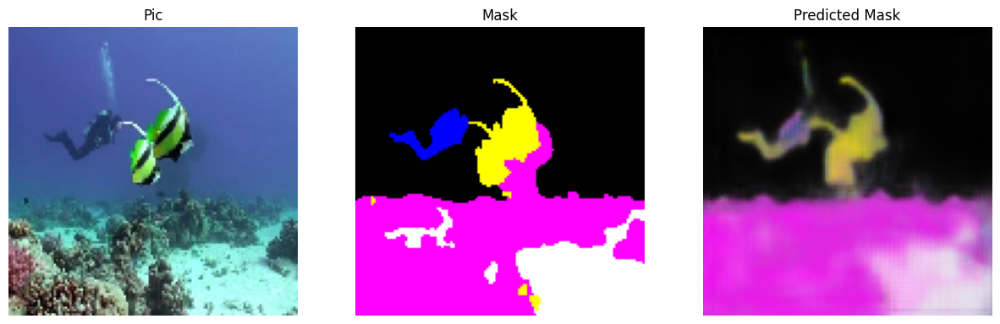

343/343 [==============================] - 43s 127ms/step - loss: 0.4353 - iou: 0.5349 - dice_coef: 0.6939 - binary_accuracy: 0.6255 - val_loss: 0.4005 - val_iou: 0.5682 - val_dice_coef: 0.7206 - val_binary_accuracy: 0.8185
Epoch 48/100
1/1 [==============================] - 0s 24ms/step- loss: 0.4347 - iou: 0.5343 - dice_coef: 0.6930 - binary_accuracy: 0.62


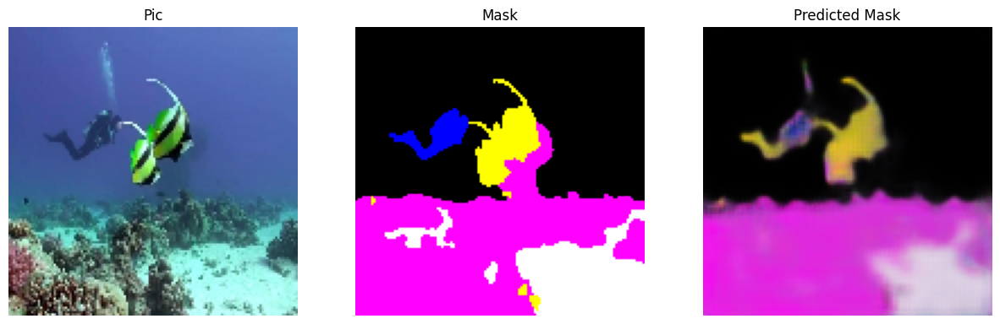

343/343 [==============================] - 43s 127ms/step - loss: 0.4347 - iou: 0.5343 - dice_coef: 0.6930 - binary_accuracy: 0.6254 - val_loss: 0.3920 - val_iou: 0.5775 - val_dice_coef: 0.7290 - val_binary_accuracy: 0.8252
Epoch 49/100
1/1 [==============================] - 0s 25ms/step- loss: 0.4346 - iou: 0.5312 - dice_coef: 0.6902 - binary_accuracy: 0.61


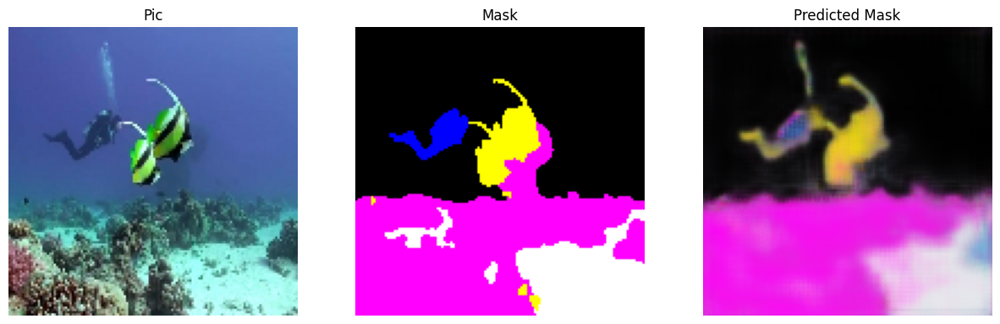

343/343 [==============================] - 43s 127ms/step - loss: 0.4346 - iou: 0.5312 - dice_coef: 0.6902 - binary_accuracy: 0.6156 - val_loss: 0.4327 - val_iou: 0.6071 - val_dice_coef: 0.7496 - val_binary_accuracy: 0.7989
Epoch 50/100
1/1 [==============================] - 0s 26ms/step- loss: 0.4367 - iou: 0.5320 - dice_coef: 0.6909 - binary_accuracy: 0.61


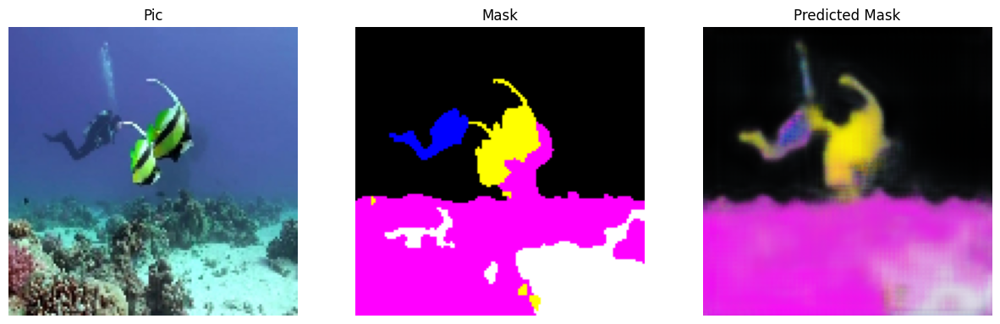

343/343 [==============================] - 43s 126ms/step - loss: 0.4367 - iou: 0.5320 - dice_coef: 0.6909 - binary_accuracy: 0.6147 - val_loss: 0.3888 - val_iou: 0.5846 - val_dice_coef: 0.7330 - val_binary_accuracy: 0.8232
Epoch 51/100
1/1 [==============================] - 0s 29ms/step- loss: 0.4306 - iou: 0.5375 - dice_coef: 0.6947 - binary_accuracy: 0.62


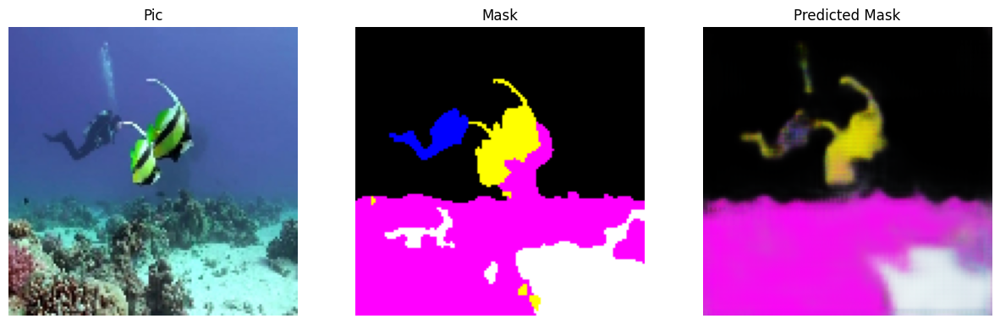

343/343 [==============================] - 44s 127ms/step - loss: 0.4306 - iou: 0.5375 - dice_coef: 0.6947 - binary_accuracy: 0.6228 - val_loss: 0.3925 - val_iou: 0.5625 - val_dice_coef: 0.7124 - val_binary_accuracy: 0.8233
Epoch 52/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4346 - iou: 0.5350 - dice_coef: 0.6936 - binary_accuracy: 0.62


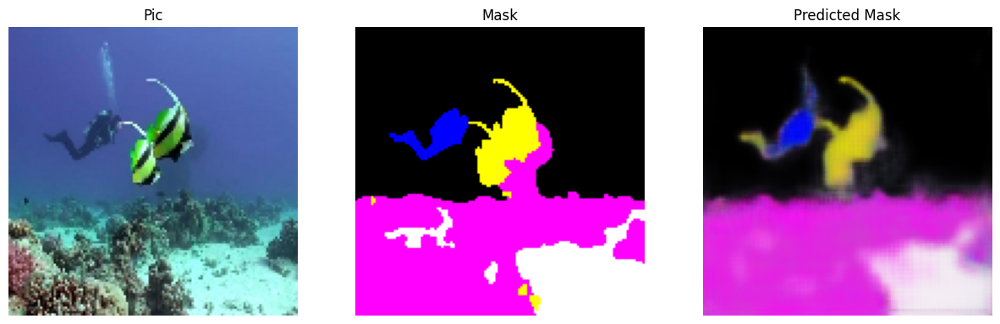

343/343 [==============================] - 43s 126ms/step - loss: 0.4346 - iou: 0.5350 - dice_coef: 0.6936 - binary_accuracy: 0.6261 - val_loss: 0.4096 - val_iou: 0.5509 - val_dice_coef: 0.7047 - val_binary_accuracy: 0.8097
Epoch 53/100
1/1 [==============================] - 0s 24ms/step- loss: 0.4311 - iou: 0.5373 - dice_coef: 0.6955 - binary_accuracy: 0.62


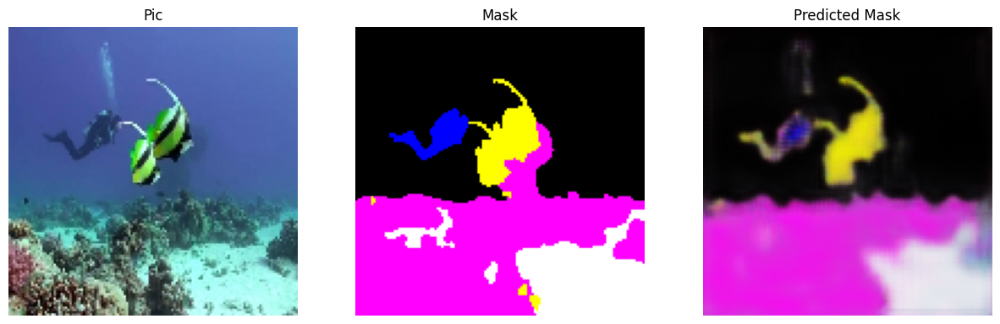

343/343 [==============================] - 43s 126ms/step - loss: 0.4311 - iou: 0.5373 - dice_coef: 0.6955 - binary_accuracy: 0.6204 - val_loss: 0.3933 - val_iou: 0.5894 - val_dice_coef: 0.7377 - val_binary_accuracy: 0.8311
Epoch 54/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4229 - iou: 0.5444 - dice_coef: 0.7012 - binary_accuracy: 0.63


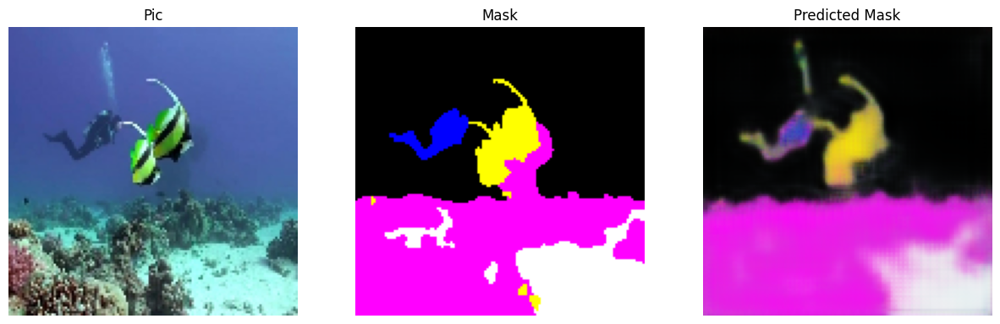

343/343 [==============================] - 43s 126ms/step - loss: 0.4229 - iou: 0.5444 - dice_coef: 0.7012 - binary_accuracy: 0.6337 - val_loss: 0.4020 - val_iou: 0.5805 - val_dice_coef: 0.7253 - val_binary_accuracy: 0.8119
Epoch 55/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4236 - iou: 0.5439 - dice_coef: 0.7007 - binary_accuracy: 0.62


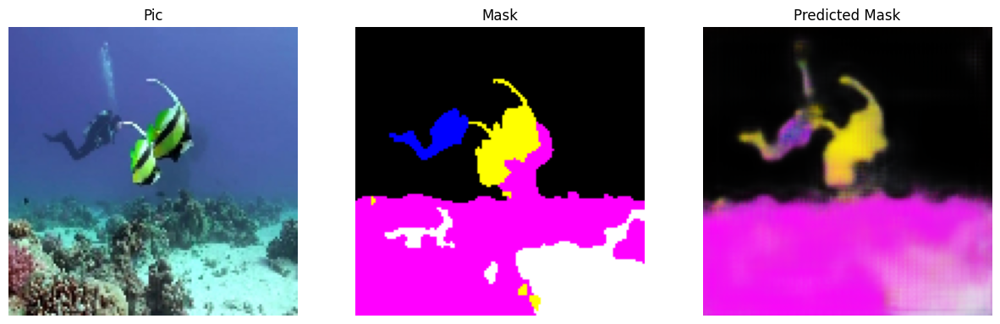

343/343 [==============================] - 43s 126ms/step - loss: 0.4236 - iou: 0.5439 - dice_coef: 0.7007 - binary_accuracy: 0.6286 - val_loss: 0.3822 - val_iou: 0.5949 - val_dice_coef: 0.7399 - val_binary_accuracy: 0.8215
Epoch 56/100
1/1 [==============================] - 0s 21ms/step- loss: 0.4224 - iou: 0.5439 - dice_coef: 0.7002 - binary_accuracy: 0.63


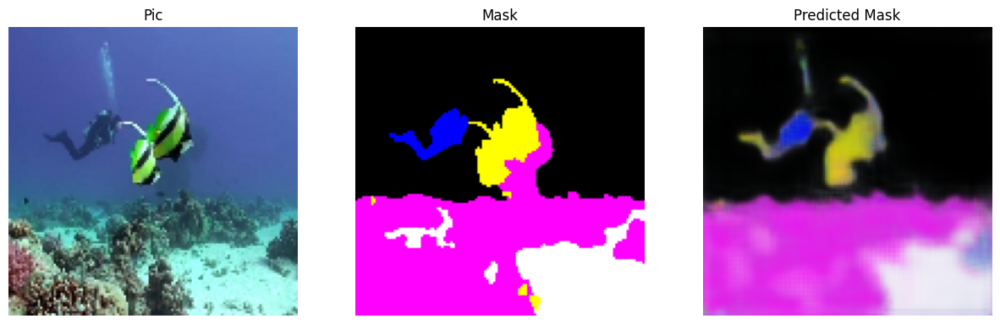

343/343 [==============================] - 43s 127ms/step - loss: 0.4224 - iou: 0.5439 - dice_coef: 0.7002 - binary_accuracy: 0.6345 - val_loss: 0.4221 - val_iou: 0.5811 - val_dice_coef: 0.7320 - val_binary_accuracy: 0.8067
Epoch 57/100
1/1 [==============================] - 0s 24ms/step- loss: 0.4178 - iou: 0.5488 - dice_coef: 0.7053 - binary_accuracy: 0.62


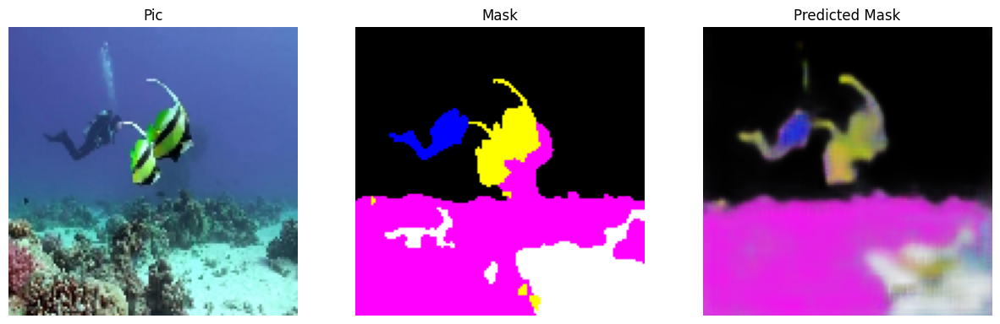

343/343 [==============================] - 43s 126ms/step - loss: 0.4178 - iou: 0.5488 - dice_coef: 0.7053 - binary_accuracy: 0.6242 - val_loss: 0.4265 - val_iou: 0.5209 - val_dice_coef: 0.6775 - val_binary_accuracy: 0.7962
Epoch 58/100
1/1 [==============================] - 0s 21ms/step- loss: 0.4286 - iou: 0.5391 - dice_coef: 0.6965 - binary_accuracy: 0.61


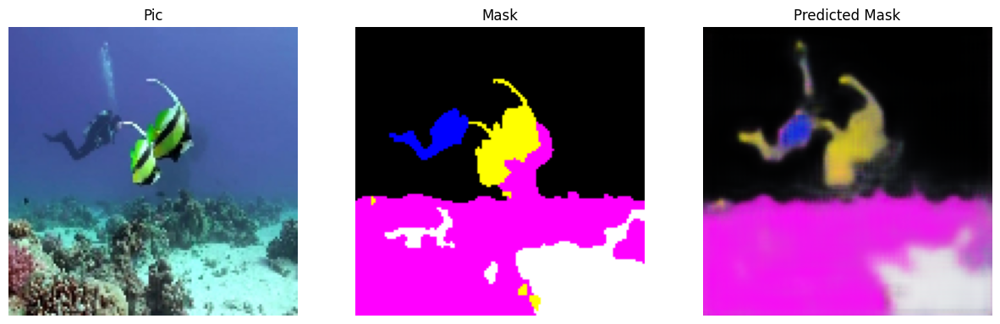

343/343 [==============================] - 43s 127ms/step - loss: 0.4286 - iou: 0.5391 - dice_coef: 0.6965 - binary_accuracy: 0.6131 - val_loss: 0.3857 - val_iou: 0.5930 - val_dice_coef: 0.7399 - val_binary_accuracy: 0.8252
Epoch 59/100
1/1 [==============================] - 0s 29ms/step- loss: 0.4172 - iou: 0.5501 - dice_coef: 0.7058 - binary_accuracy: 0.63


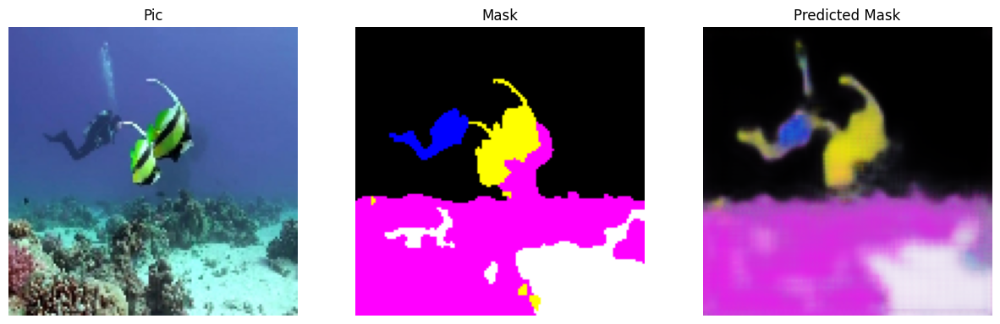

343/343 [==============================] - 44s 127ms/step - loss: 0.4172 - iou: 0.5501 - dice_coef: 0.7058 - binary_accuracy: 0.6328 - val_loss: 0.3819 - val_iou: 0.5793 - val_dice_coef: 0.7318 - val_binary_accuracy: 0.8268
Epoch 60/100
1/1 [==============================] - 0s 25ms/step- loss: 0.4115 - iou: 0.5526 - dice_coef: 0.7079 - binary_accuracy: 0.63


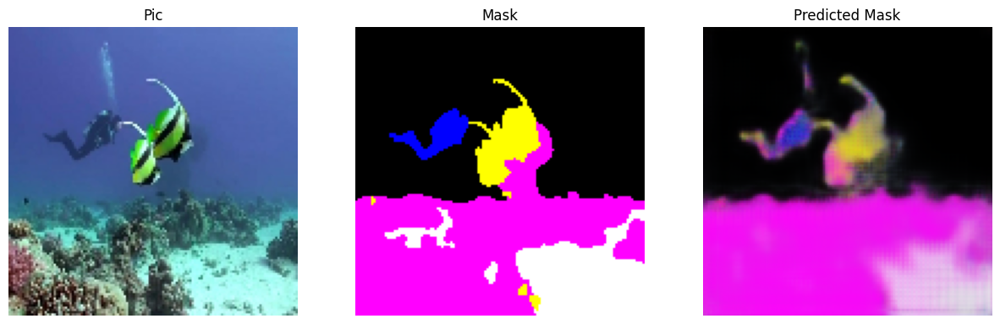

343/343 [==============================] - 44s 129ms/step - loss: 0.4115 - iou: 0.5526 - dice_coef: 0.7079 - binary_accuracy: 0.6348 - val_loss: 0.3946 - val_iou: 0.6313 - val_dice_coef: 0.7710 - val_binary_accuracy: 0.8185
Epoch 61/100
1/1 [==============================] - 0s 24ms/step- loss: 0.4137 - iou: 0.5533 - dice_coef: 0.7088 - binary_accuracy: 0.63


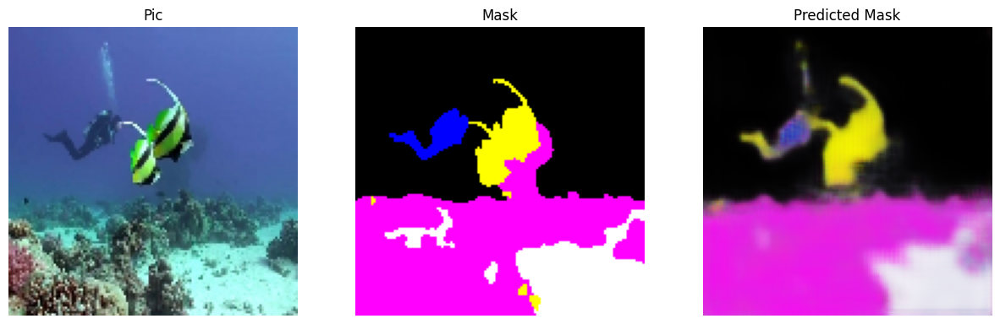

343/343 [==============================] - 43s 126ms/step - loss: 0.4137 - iou: 0.5533 - dice_coef: 0.7088 - binary_accuracy: 0.6306 - val_loss: 0.4065 - val_iou: 0.5767 - val_dice_coef: 0.7244 - val_binary_accuracy: 0.8002
Epoch 62/100
1/1 [==============================] - 0s 24ms/step- loss: 0.4093 - iou: 0.5575 - dice_coef: 0.7122 - binary_accuracy: 0.62


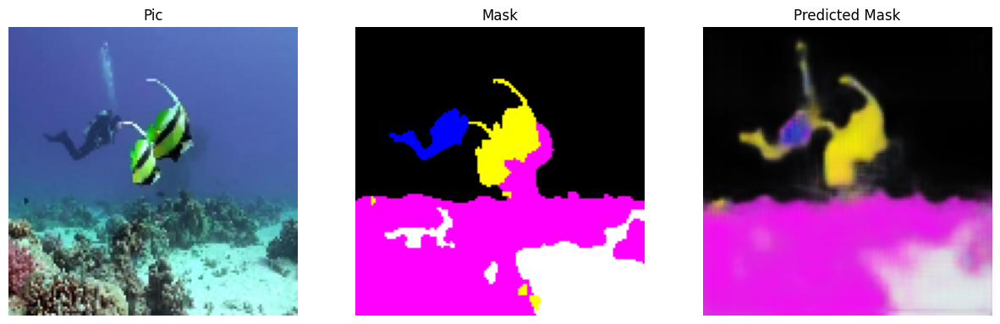

343/343 [==============================] - 44s 129ms/step - loss: 0.4093 - iou: 0.5575 - dice_coef: 0.7122 - binary_accuracy: 0.6228 - val_loss: 0.3915 - val_iou: 0.5966 - val_dice_coef: 0.7440 - val_binary_accuracy: 0.8205
Epoch 63/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4060 - iou: 0.5622 - dice_coef: 0.7161 - binary_accuracy: 0.65


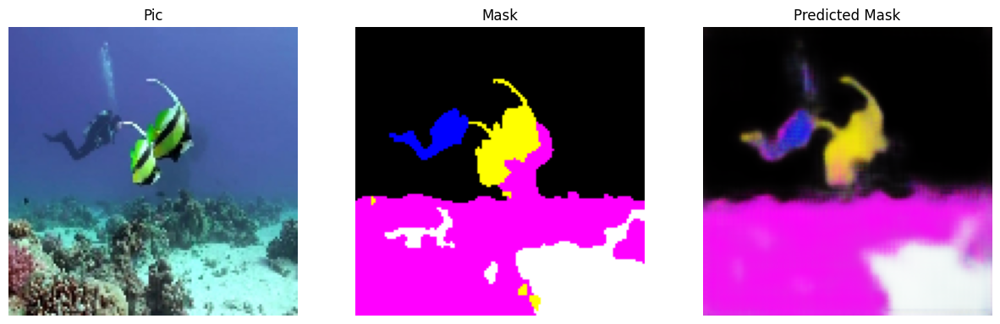

343/343 [==============================] - 43s 126ms/step - loss: 0.4060 - iou: 0.5622 - dice_coef: 0.7161 - binary_accuracy: 0.6511 - val_loss: 0.3957 - val_iou: 0.6111 - val_dice_coef: 0.7552 - val_binary_accuracy: 0.8198
Epoch 64/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4127 - iou: 0.5531 - dice_coef: 0.7084 - binary_accuracy: 0.62


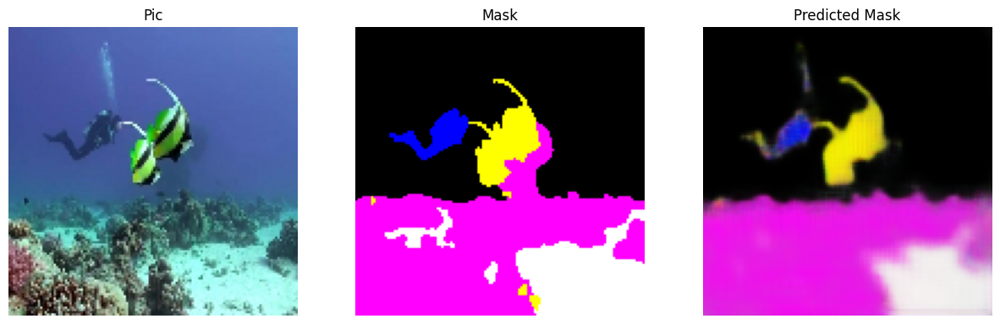

343/343 [==============================] - 43s 127ms/step - loss: 0.4127 - iou: 0.5531 - dice_coef: 0.7084 - binary_accuracy: 0.6283 - val_loss: 0.3959 - val_iou: 0.6002 - val_dice_coef: 0.7454 - val_binary_accuracy: 0.8227
Epoch 65/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4133 - iou: 0.5549 - dice_coef: 0.7099 - binary_accuracy: 0.63


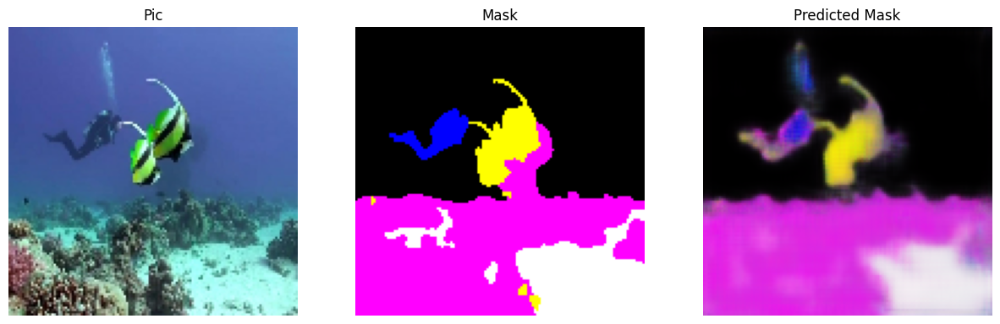

343/343 [==============================] - 43s 126ms/step - loss: 0.4133 - iou: 0.5549 - dice_coef: 0.7099 - binary_accuracy: 0.6373 - val_loss: 0.3742 - val_iou: 0.5486 - val_dice_coef: 0.6965 - val_binary_accuracy: 0.8335
Epoch 66/100
1/1 [==============================] - 0s 21ms/step- loss: 0.4087 - iou: 0.5564 - dice_coef: 0.7112 - binary_accuracy: 0.63


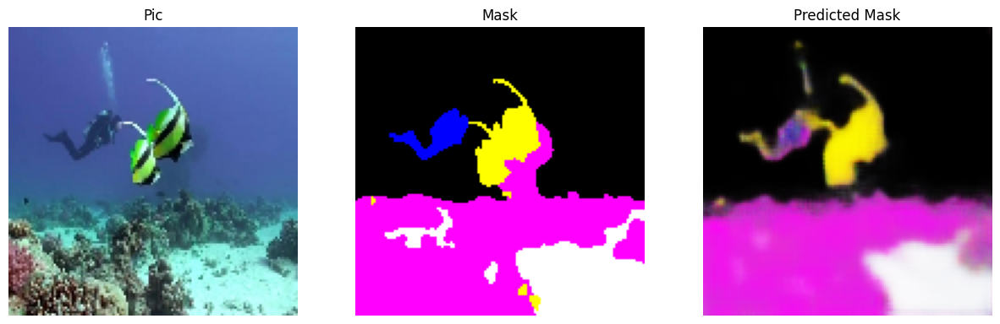

343/343 [==============================] - 43s 125ms/step - loss: 0.4087 - iou: 0.5564 - dice_coef: 0.7112 - binary_accuracy: 0.6339 - val_loss: 0.3820 - val_iou: 0.5893 - val_dice_coef: 0.7353 - val_binary_accuracy: 0.8262
Epoch 67/100
1/1 [==============================] - 0s 24ms/step- loss: 0.4085 - iou: 0.5573 - dice_coef: 0.7121 - binary_accuracy: 0.62


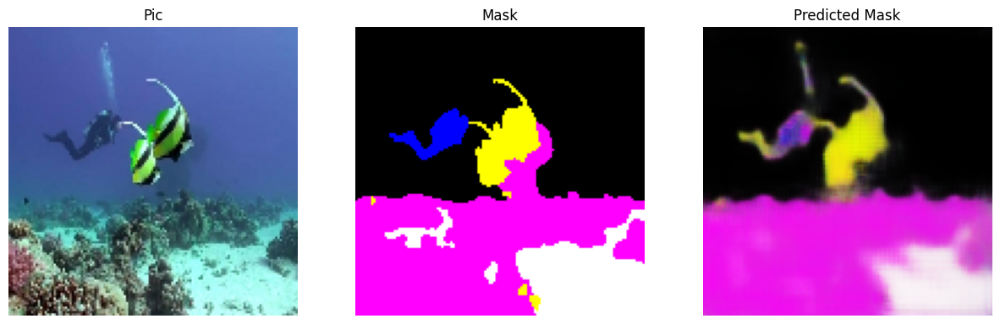

343/343 [==============================] - 43s 125ms/step - loss: 0.4085 - iou: 0.5573 - dice_coef: 0.7121 - binary_accuracy: 0.6285 - val_loss: 0.3854 - val_iou: 0.6179 - val_dice_coef: 0.7606 - val_binary_accuracy: 0.8238
Epoch 68/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4086 - iou: 0.5561 - dice_coef: 0.7112 - binary_accuracy: 0.62


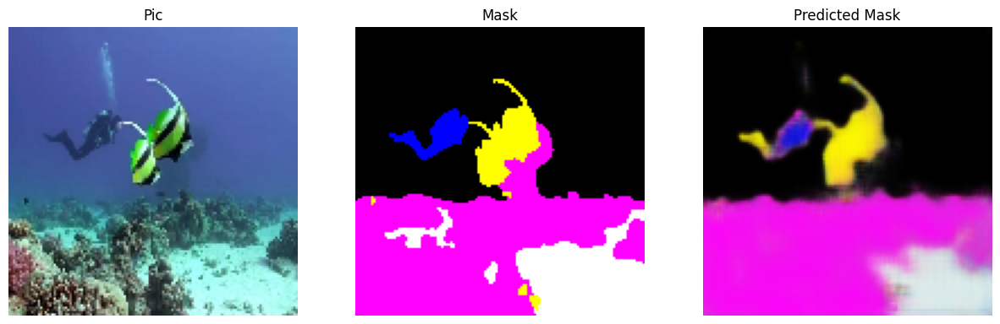

343/343 [==============================] - 43s 125ms/step - loss: 0.4086 - iou: 0.5561 - dice_coef: 0.7112 - binary_accuracy: 0.6291 - val_loss: 0.3691 - val_iou: 0.6264 - val_dice_coef: 0.7664 - val_binary_accuracy: 0.8370
Epoch 69/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4031 - iou: 0.5639 - dice_coef: 0.7177 - binary_accuracy: 0.63


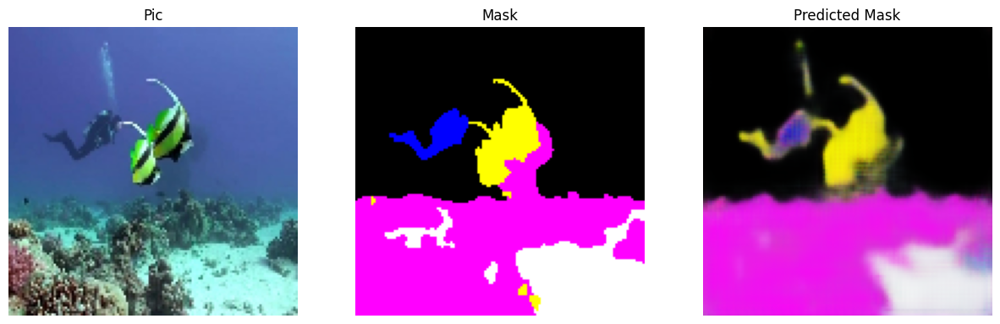

343/343 [==============================] - 43s 126ms/step - loss: 0.4031 - iou: 0.5639 - dice_coef: 0.7177 - binary_accuracy: 0.6353 - val_loss: 0.3847 - val_iou: 0.5845 - val_dice_coef: 0.7339 - val_binary_accuracy: 0.8257
Epoch 70/100
1/1 [==============================] - 0s 23ms/step- loss: 0.4032 - iou: 0.5641 - dice_coef: 0.7179 - binary_accuracy: 0.63


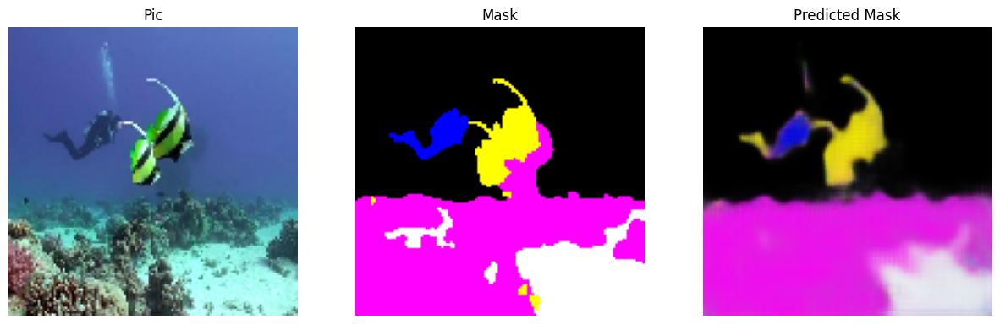

343/343 [==============================] - 43s 126ms/step - loss: 0.4032 - iou: 0.5641 - dice_coef: 0.7179 - binary_accuracy: 0.6323 - val_loss: 0.3792 - val_iou: 0.5791 - val_dice_coef: 0.7261 - val_binary_accuracy: 0.8302
Epoch 71/100
1/1 [==============================] - 0s 23ms/step- loss: 0.4046 - iou: 0.5607 - dice_coef: 0.7148 - binary_accuracy: 0.63


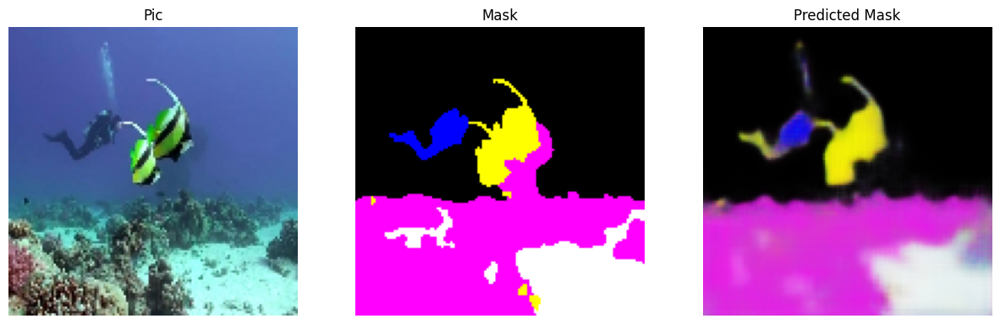

343/343 [==============================] - 43s 125ms/step - loss: 0.4046 - iou: 0.5607 - dice_coef: 0.7148 - binary_accuracy: 0.6314 - val_loss: 0.3949 - val_iou: 0.5735 - val_dice_coef: 0.7241 - val_binary_accuracy: 0.8222
Epoch 72/100
1/1 [==============================] - 0s 22ms/step- loss: 0.3939 - iou: 0.5739 - dice_coef: 0.7263 - binary_accuracy: 0.63


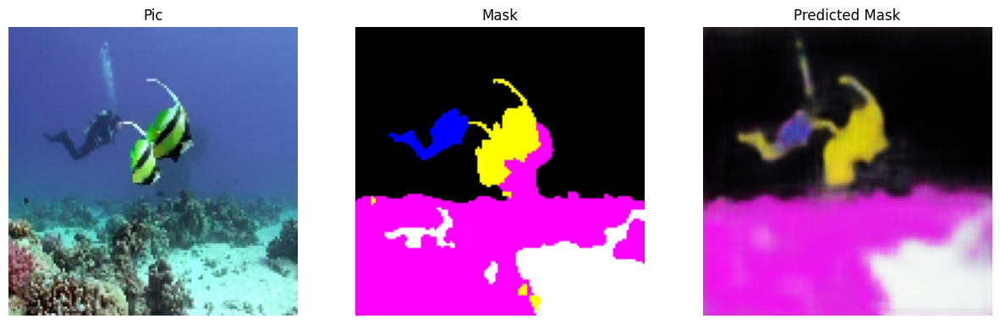

343/343 [==============================] - 43s 126ms/step - loss: 0.3939 - iou: 0.5739 - dice_coef: 0.7263 - binary_accuracy: 0.6354 - val_loss: 0.4489 - val_iou: 0.5746 - val_dice_coef: 0.7273 - val_binary_accuracy: 0.7929
Epoch 73/100
1/1 [==============================] - 0s 24ms/step- loss: 0.4031 - iou: 0.5626 - dice_coef: 0.7170 - binary_accuracy: 0.63


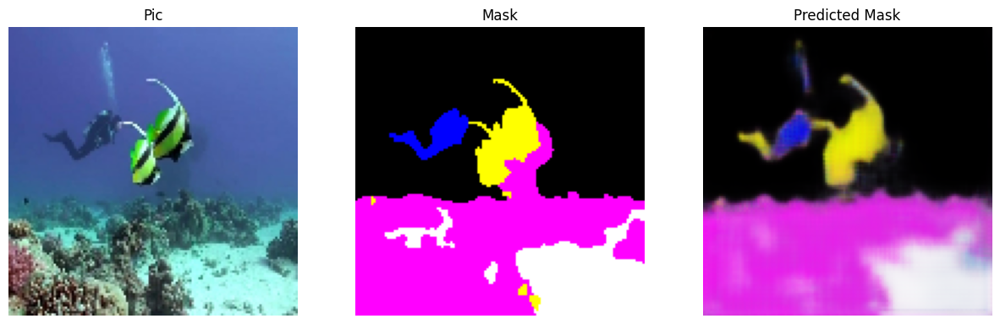

343/343 [==============================] - 44s 128ms/step - loss: 0.4031 - iou: 0.5626 - dice_coef: 0.7170 - binary_accuracy: 0.6352 - val_loss: 0.3589 - val_iou: 0.6271 - val_dice_coef: 0.7681 - val_binary_accuracy: 0.8447
Epoch 74/100
1/1 [==============================] - 0s 22ms/step- loss: 0.3963 - iou: 0.5713 - dice_coef: 0.7242 - binary_accuracy: 0.64


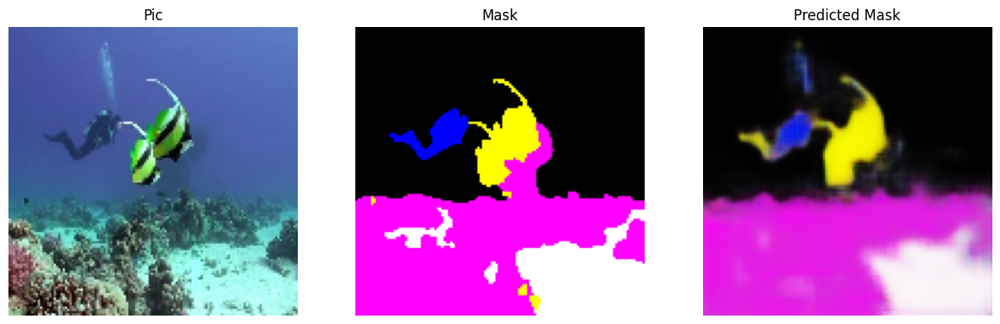

343/343 [==============================] - 43s 126ms/step - loss: 0.3963 - iou: 0.5713 - dice_coef: 0.7242 - binary_accuracy: 0.6442 - val_loss: 0.3969 - val_iou: 0.5858 - val_dice_coef: 0.7357 - val_binary_accuracy: 0.8183
Epoch 75/100
1/1 [==============================] - 0s 24ms/step- loss: 0.3945 - iou: 0.5720 - dice_coef: 0.7241 - binary_accuracy: 0.63


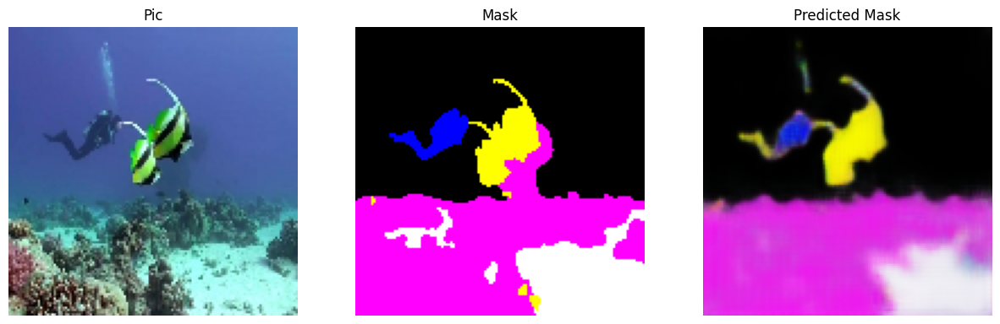

343/343 [==============================] - 43s 126ms/step - loss: 0.3945 - iou: 0.5720 - dice_coef: 0.7241 - binary_accuracy: 0.6393 - val_loss: 0.3814 - val_iou: 0.5849 - val_dice_coef: 0.7344 - val_binary_accuracy: 0.8293
Epoch 76/100
1/1 [==============================] - 0s 22ms/step- loss: 0.3958 - iou: 0.5737 - dice_coef: 0.7257 - binary_accuracy: 0.63


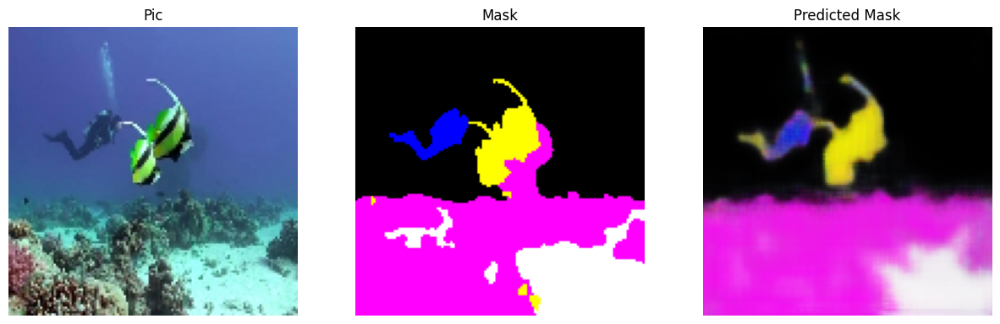

343/343 [==============================] - 43s 126ms/step - loss: 0.3958 - iou: 0.5737 - dice_coef: 0.7257 - binary_accuracy: 0.6384 - val_loss: 0.4019 - val_iou: 0.6142 - val_dice_coef: 0.7579 - val_binary_accuracy: 0.8129
Epoch 77/100
1/1 [==============================] - 0s 26ms/step- loss: 0.3915 - iou: 0.5735 - dice_coef: 0.7256 - binary_accuracy: 0.64


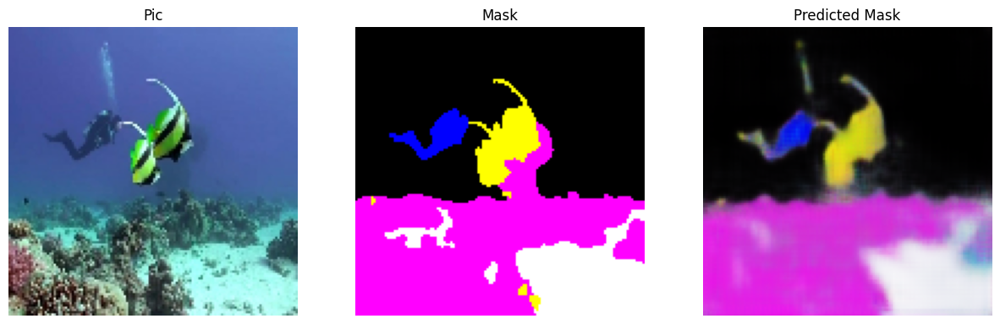

343/343 [==============================] - 43s 127ms/step - loss: 0.3915 - iou: 0.5735 - dice_coef: 0.7256 - binary_accuracy: 0.6441 - val_loss: 0.3743 - val_iou: 0.5949 - val_dice_coef: 0.7431 - val_binary_accuracy: 0.8363
Epoch 78/100
1/1 [==============================] - 0s 27ms/step- loss: 0.3918 - iou: 0.5751 - dice_coef: 0.7275 - binary_accuracy: 0.63


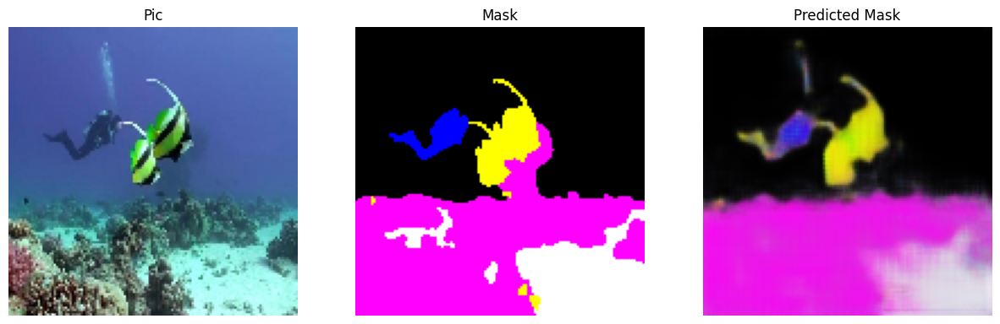

343/343 [==============================] - 44s 128ms/step - loss: 0.3918 - iou: 0.5751 - dice_coef: 0.7275 - binary_accuracy: 0.6358 - val_loss: 0.3758 - val_iou: 0.5777 - val_dice_coef: 0.7251 - val_binary_accuracy: 0.8287
Epoch 79/100
1/1 [==============================] - 0s 26ms/step- loss: 0.4292 - iou: 0.5463 - dice_coef: 0.7016 - binary_accuracy: 0.62


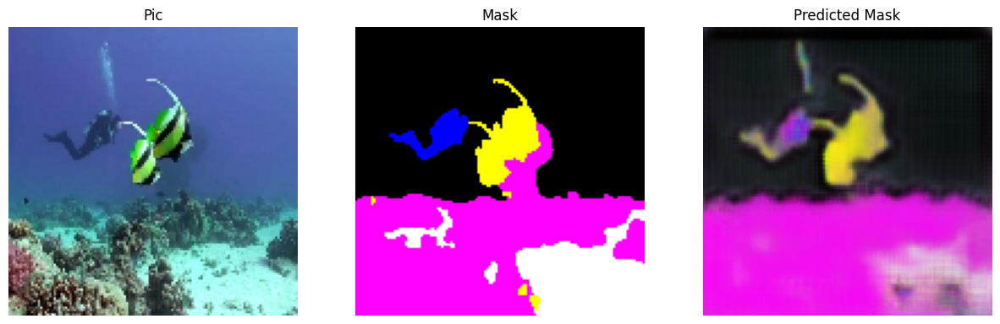

343/343 [==============================] - 44s 129ms/step - loss: 0.4292 - iou: 0.5463 - dice_coef: 0.7016 - binary_accuracy: 0.6294 - val_loss: 0.4574 - val_iou: 0.5574 - val_dice_coef: 0.7084 - val_binary_accuracy: 0.7810
Epoch 80/100
1/1 [==============================] - 0s 22ms/step- loss: 0.4220 - iou: 0.5466 - dice_coef: 0.7028 - binary_accuracy: 0.63


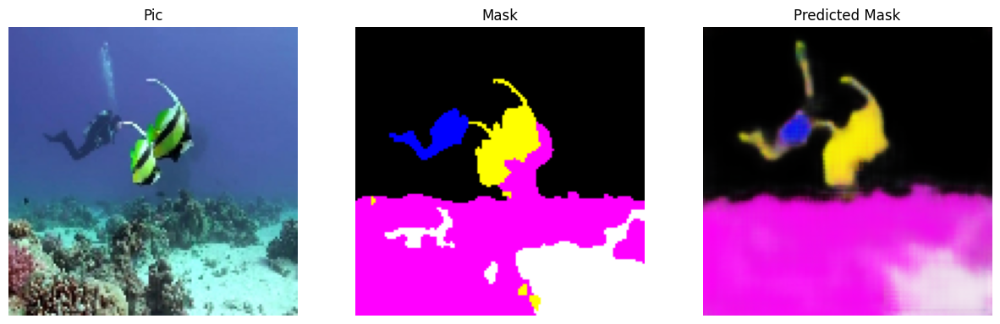

343/343 [==============================] - 44s 128ms/step - loss: 0.4220 - iou: 0.5466 - dice_coef: 0.7028 - binary_accuracy: 0.6306 - val_loss: 0.3714 - val_iou: 0.6224 - val_dice_coef: 0.7628 - val_binary_accuracy: 0.8290
Epoch 81/100
1/1 [==============================] - 0s 32ms/step- loss: 0.3953 - iou: 0.5701 - dice_coef: 0.7224 - binary_accuracy: 0.63


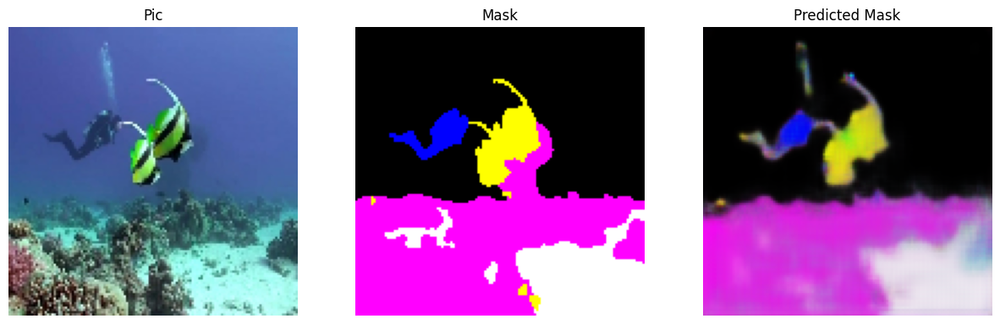

343/343 [==============================] - 43s 126ms/step - loss: 0.3953 - iou: 0.5701 - dice_coef: 0.7224 - binary_accuracy: 0.6344 - val_loss: 0.4287 - val_iou: 0.5522 - val_dice_coef: 0.7085 - val_binary_accuracy: 0.7971
Epoch 82/100
1/1 [==============================] - 0s 25ms/step- loss: 0.3916 - iou: 0.5772 - dice_coef: 0.7288 - binary_accuracy: 0.63


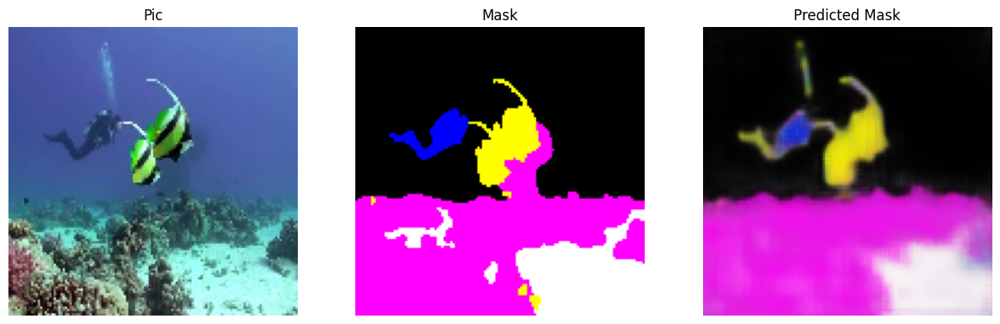

343/343 [==============================] - 44s 127ms/step - loss: 0.3916 - iou: 0.5772 - dice_coef: 0.7288 - binary_accuracy: 0.6383 - val_loss: 0.3855 - val_iou: 0.5812 - val_dice_coef: 0.7315 - val_binary_accuracy: 0.8271
Epoch 83/100
1/1 [==============================] - 0s 26ms/step- loss: 0.3841 - iou: 0.5828 - dice_coef: 0.7330 - binary_accuracy: 0.64


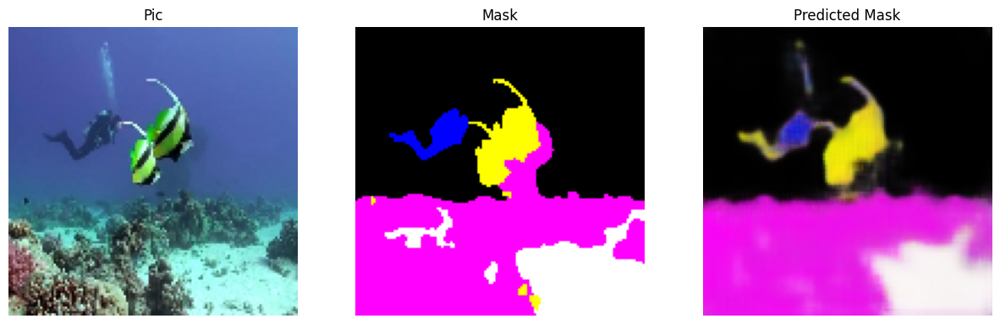

343/343 [==============================] - 44s 127ms/step - loss: 0.3841 - iou: 0.5828 - dice_coef: 0.7330 - binary_accuracy: 0.6443 - val_loss: 0.3724 - val_iou: 0.6217 - val_dice_coef: 0.7623 - val_binary_accuracy: 0.8332
Epoch 84/100
1/1 [==============================] - 0s 27ms/step- loss: 0.3829 - iou: 0.5822 - dice_coef: 0.7329 - binary_accuracy: 0.63


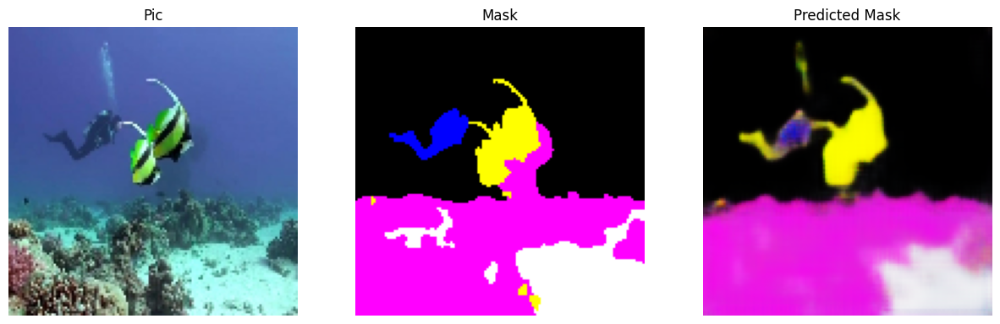

343/343 [==============================] - 44s 129ms/step - loss: 0.3829 - iou: 0.5822 - dice_coef: 0.7329 - binary_accuracy: 0.6382 - val_loss: 0.3912 - val_iou: 0.6015 - val_dice_coef: 0.7465 - val_binary_accuracy: 0.8185
Epoch 85/100
1/1 [==============================] - 0s 22ms/step- loss: 0.3844 - iou: 0.5806 - dice_coef: 0.7308 - binary_accuracy: 0.64


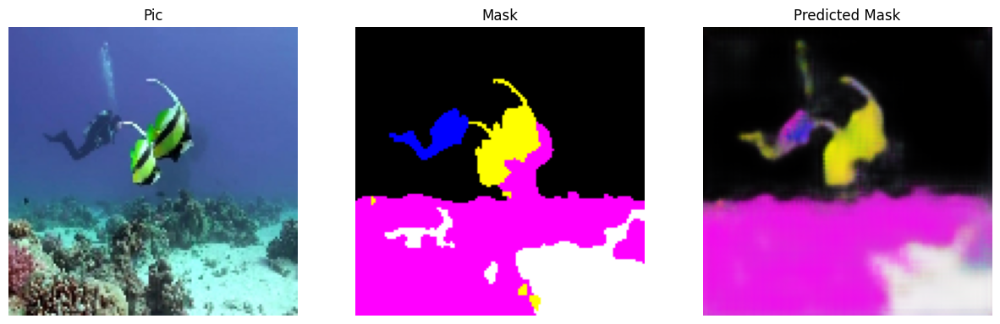

343/343 [==============================] - 44s 128ms/step - loss: 0.3844 - iou: 0.5806 - dice_coef: 0.7308 - binary_accuracy: 0.6428 - val_loss: 0.3717 - val_iou: 0.5872 - val_dice_coef: 0.7351 - val_binary_accuracy: 0.8331
Epoch 86/100
1/1 [==============================] - 0s 22ms/step- loss: 0.3823 - iou: 0.5844 - dice_coef: 0.7345 - binary_accuracy: 0.64


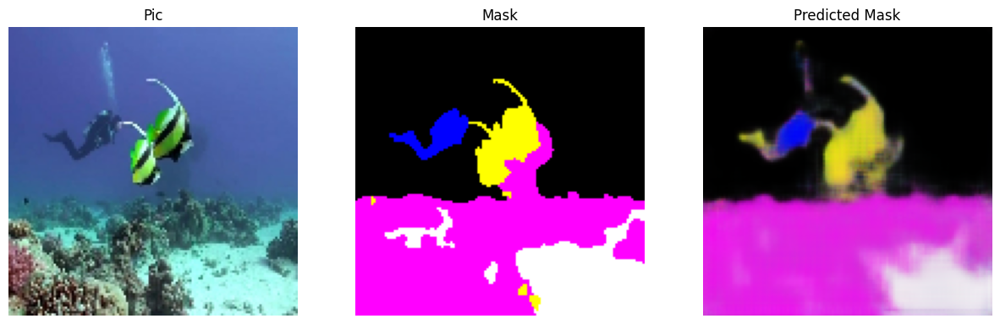

343/343 [==============================] - 43s 126ms/step - loss: 0.3823 - iou: 0.5844 - dice_coef: 0.7345 - binary_accuracy: 0.6467 - val_loss: 0.3614 - val_iou: 0.6152 - val_dice_coef: 0.7600 - val_binary_accuracy: 0.8370
Epoch 87/100
1/1 [==============================] - 0s 23ms/step- loss: 0.3782 - iou: 0.5904 - dice_coef: 0.7393 - binary_accuracy: 0.65


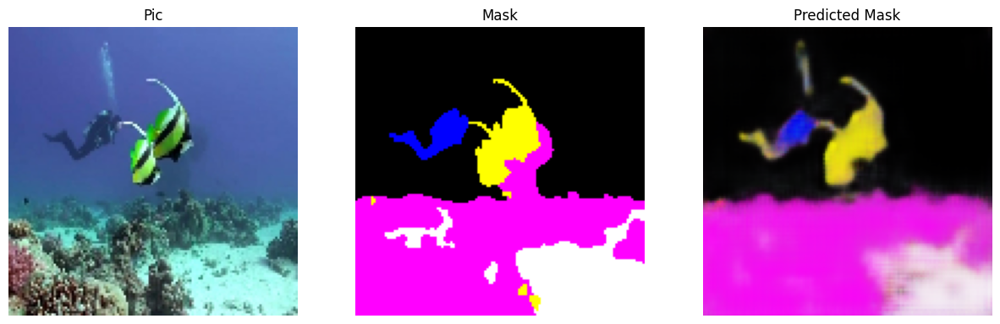

343/343 [==============================] - 43s 126ms/step - loss: 0.3782 - iou: 0.5904 - dice_coef: 0.7393 - binary_accuracy: 0.6571 - val_loss: 0.3739 - val_iou: 0.6054 - val_dice_coef: 0.7472 - val_binary_accuracy: 0.8253
Epoch 88/100
1/1 [==============================] - 0s 29ms/step- loss: 0.3863 - iou: 0.5779 - dice_coef: 0.7291 - binary_accuracy: 0.63


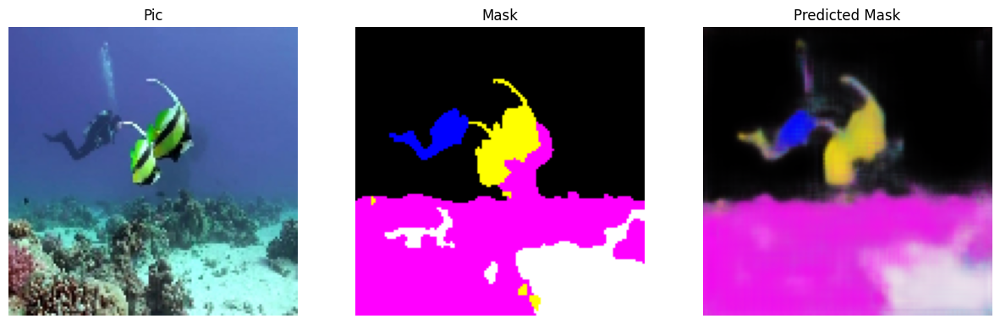

343/343 [==============================] - 43s 127ms/step - loss: 0.3863 - iou: 0.5779 - dice_coef: 0.7291 - binary_accuracy: 0.6355 - val_loss: 0.3844 - val_iou: 0.5930 - val_dice_coef: 0.7419 - val_binary_accuracy: 0.8264
Epoch 89/100
1/1 [==============================] - 0s 25ms/step- loss: 0.3809 - iou: 0.5854 - dice_coef: 0.7354 - binary_accuracy: 0.63


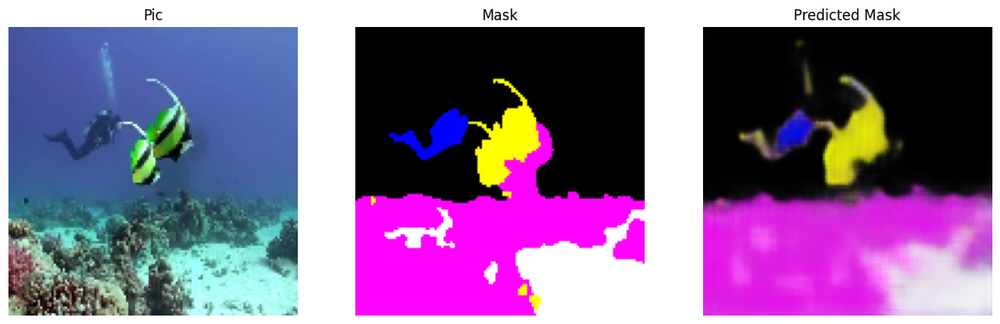

343/343 [==============================] - 44s 128ms/step - loss: 0.3809 - iou: 0.5854 - dice_coef: 0.7354 - binary_accuracy: 0.6355 - val_loss: 0.3783 - val_iou: 0.5824 - val_dice_coef: 0.7320 - val_binary_accuracy: 0.8322
Epoch 90/100
1/1 [==============================] - 0s 23ms/step- loss: 0.3768 - iou: 0.5884 - dice_coef: 0.7383 - binary_accuracy: 0.64


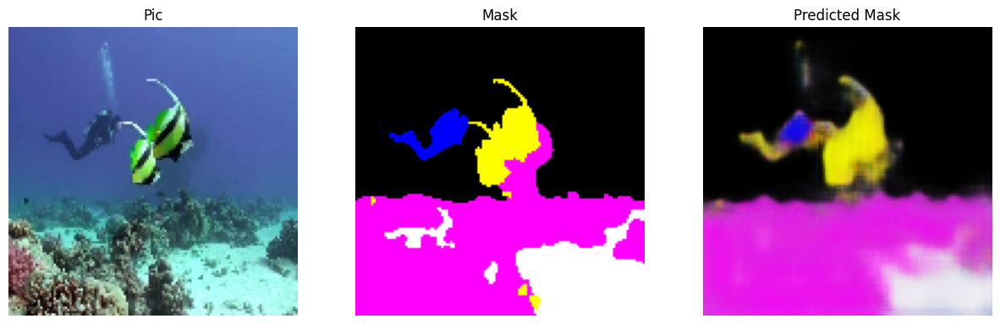

343/343 [==============================] - 44s 128ms/step - loss: 0.3768 - iou: 0.5884 - dice_coef: 0.7383 - binary_accuracy: 0.6481 - val_loss: 0.3796 - val_iou: 0.5920 - val_dice_coef: 0.7386 - val_binary_accuracy: 0.8245
Epoch 91/100
1/1 [==============================] - 0s 22ms/step- loss: 0.3758 - iou: 0.5904 - dice_coef: 0.7397 - binary_accuracy: 0.64


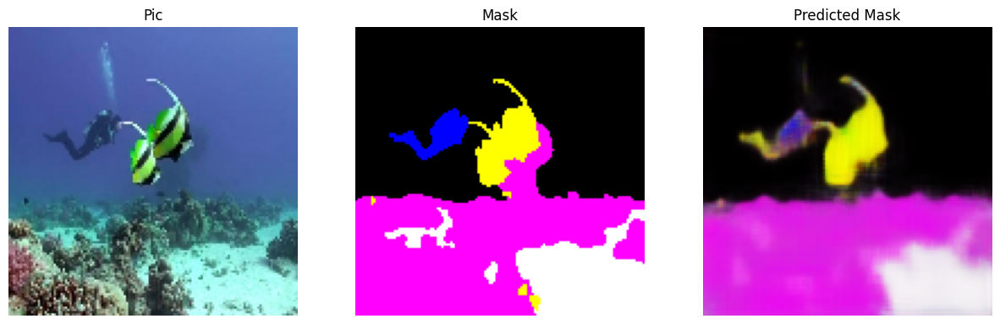

343/343 [==============================] - 44s 127ms/step - loss: 0.3758 - iou: 0.5904 - dice_coef: 0.7397 - binary_accuracy: 0.6421 - val_loss: 0.3494 - val_iou: 0.6163 - val_dice_coef: 0.7604 - val_binary_accuracy: 0.8524
Epoch 92/100
1/1 [==============================] - 0s 26ms/step- loss: 0.3732 - iou: 0.5945 - dice_coef: 0.7429 - binary_accuracy: 0.64


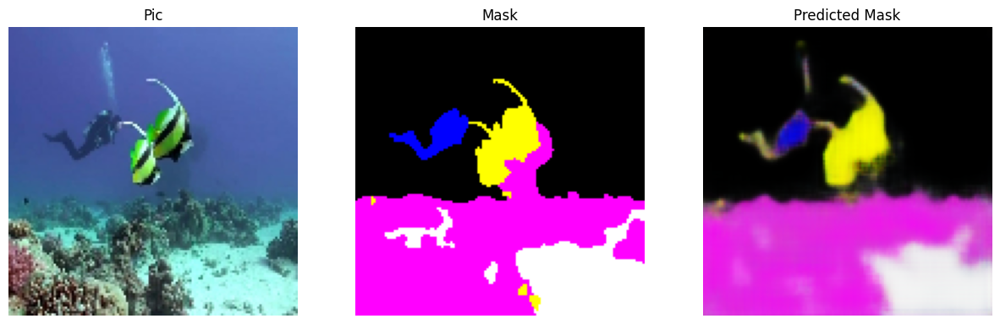

343/343 [==============================] - 44s 128ms/step - loss: 0.3732 - iou: 0.5945 - dice_coef: 0.7429 - binary_accuracy: 0.6456 - val_loss: 0.4271 - val_iou: 0.5668 - val_dice_coef: 0.7172 - val_binary_accuracy: 0.7945
Epoch 93/100
1/1 [==============================] - 0s 23ms/step- loss: 0.3742 - iou: 0.5937 - dice_coef: 0.7419 - binary_accuracy: 0.64


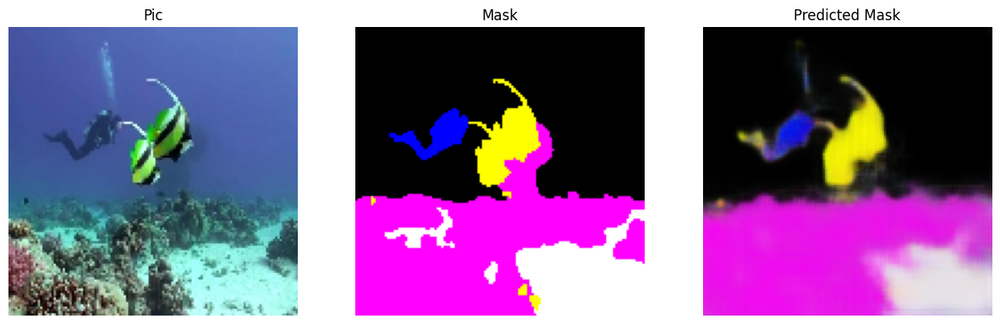

343/343 [==============================] - 44s 127ms/step - loss: 0.3742 - iou: 0.5937 - dice_coef: 0.7419 - binary_accuracy: 0.6473 - val_loss: 0.3460 - val_iou: 0.6004 - val_dice_coef: 0.7450 - val_binary_accuracy: 0.8509
Epoch 94/100
1/1 [==============================] - 0s 31ms/step- loss: 0.3712 - iou: 0.5949 - dice_coef: 0.7431 - binary_accuracy: 0.64


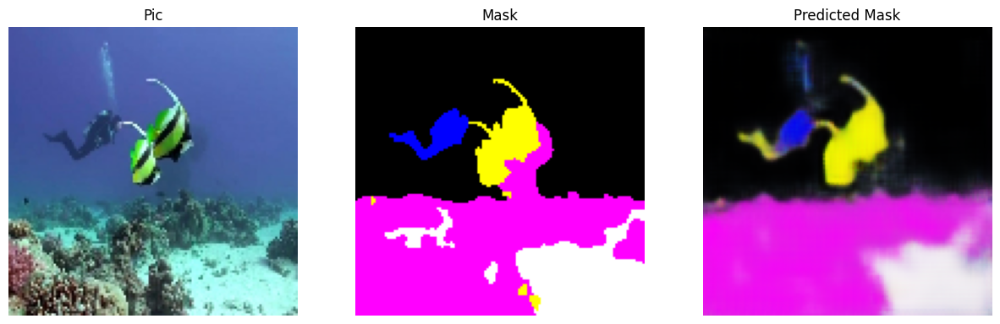

343/343 [==============================] - 44s 128ms/step - loss: 0.3712 - iou: 0.5949 - dice_coef: 0.7431 - binary_accuracy: 0.6450 - val_loss: 0.3752 - val_iou: 0.5979 - val_dice_coef: 0.7449 - val_binary_accuracy: 0.8300
Epoch 95/100
1/1 [==============================] - 0s 22ms/step- loss: 0.3700 - iou: 0.5991 - dice_coef: 0.7462 - binary_accuracy: 0.65


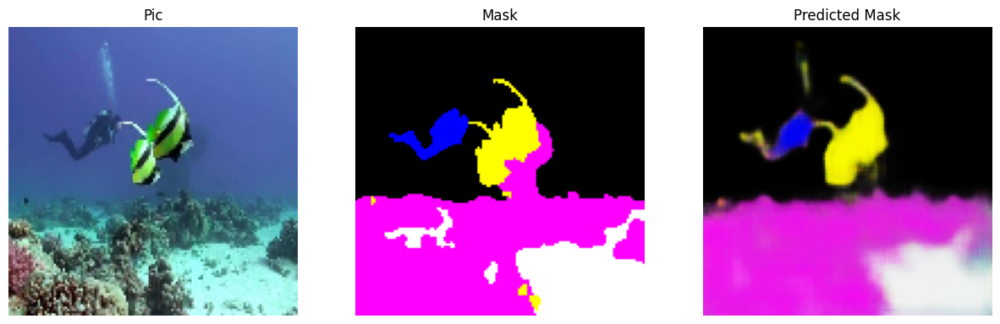

343/343 [==============================] - 43s 127ms/step - loss: 0.3700 - iou: 0.5991 - dice_coef: 0.7462 - binary_accuracy: 0.6553 - val_loss: 0.3818 - val_iou: 0.5971 - val_dice_coef: 0.7451 - val_binary_accuracy: 0.8288
Epoch 96/100
1/1 [==============================] - 0s 23ms/step- loss: 0.3798 - iou: 0.5860 - dice_coef: 0.7361 - binary_accuracy: 0.63


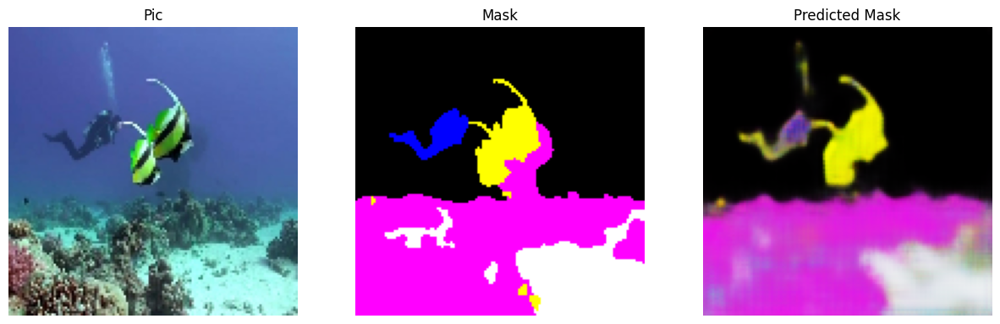

343/343 [==============================] - 44s 127ms/step - loss: 0.3798 - iou: 0.5860 - dice_coef: 0.7361 - binary_accuracy: 0.6352 - val_loss: 0.4037 - val_iou: 0.5580 - val_dice_coef: 0.7137 - val_binary_accuracy: 0.8127
Epoch 97/100
1/1 [==============================] - 0s 25ms/step- loss: 0.3662 - iou: 0.6012 - dice_coef: 0.7481 - binary_accuracy: 0.64


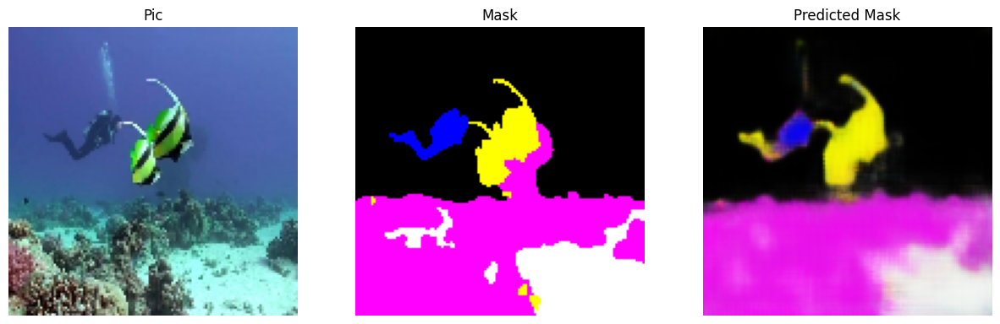

343/343 [==============================] - 43s 126ms/step - loss: 0.3662 - iou: 0.6012 - dice_coef: 0.7481 - binary_accuracy: 0.6415 - val_loss: 0.3575 - val_iou: 0.6133 - val_dice_coef: 0.7552 - val_binary_accuracy: 0.8432
Epoch 98/100
1/1 [==============================] - 0s 25ms/step- loss: 0.3814 - iou: 0.5857 - dice_coef: 0.7356 - binary_accuracy: 0.64


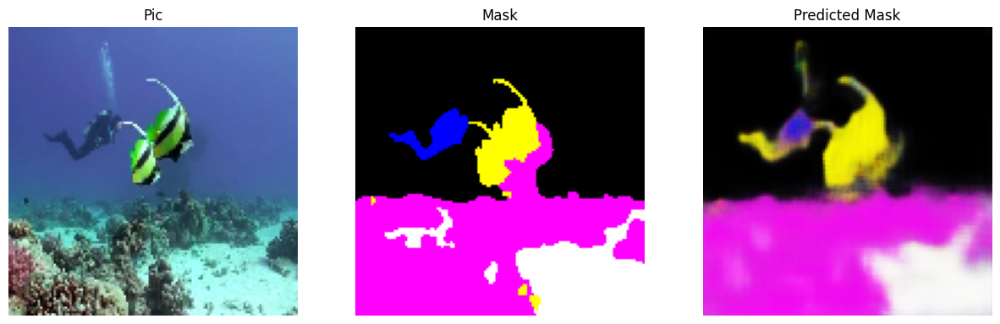

343/343 [==============================] - 43s 127ms/step - loss: 0.3814 - iou: 0.5857 - dice_coef: 0.7356 - binary_accuracy: 0.6471 - val_loss: 0.3428 - val_iou: 0.6335 - val_dice_coef: 0.7732 - val_binary_accuracy: 0.8510
Epoch 99/100
1/1 [==============================] - 0s 24ms/step- loss: 0.3675 - iou: 0.6001 - dice_coef: 0.7467 - binary_accuracy: 0.64


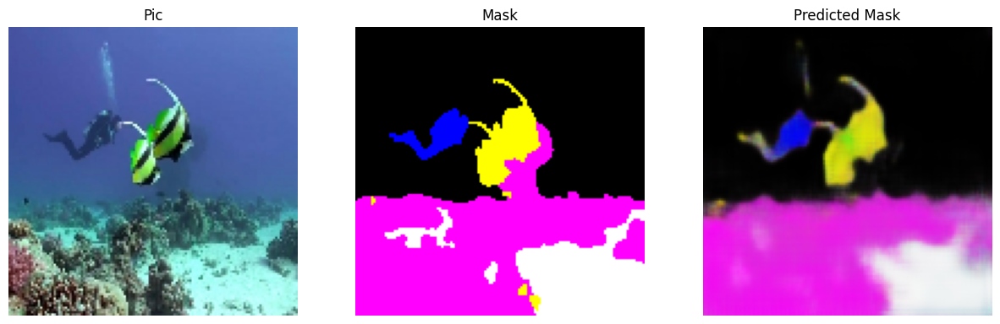

343/343 [==============================] - 44s 127ms/step - loss: 0.3675 - iou: 0.6001 - dice_coef: 0.7467 - binary_accuracy: 0.6494 - val_loss: 0.3797 - val_iou: 0.5989 - val_dice_coef: 0.7467 - val_binary_accuracy: 0.8293
Epoch 100/100
1/1 [==============================] - 0s 23ms/step- loss: 0.3656 - iou: 0.6027 - dice_coef: 0.7491 - binary_accuracy: 0.64


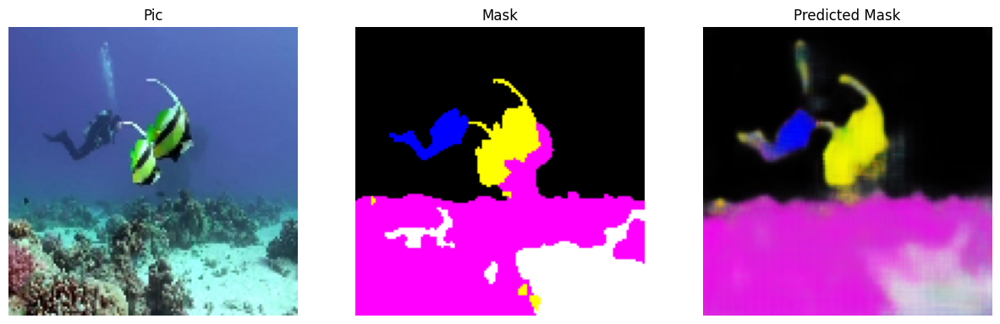

343/343 [==============================] - 44s 128ms/step - loss: 0.3656 - iou: 0.6027 - dice_coef: 0.7491 - binary_accuracy: 0.6408 - val_loss: 0.4115 - val_iou: 0.5535 - val_dice_coef: 0.7090 - val_binary_accuracy: 0.8144


In [200]:
history = model.fit(
	x = train_gen,
	steps_per_epoch = len(train) / batch_size,
	epochs = num_epochs,
    validation_data = valid_gen,
    validation_steps = len(test) / batch_size,
    
	callbacks=[ShowSample()]
)

# Evaluation

In [ ]:
epochs = np.arange(1, num_epochs + 1)

plt.figure(figsize=(12, 12))
plt.subplot(2, 2, 1)
plt.plot(epochs, history.history['loss'], 'r-', label='Training Loss')
plt.plot(epochs, history.history['val_loss'], 'b-', label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.subplot(2, 2, 2)
plt.plot(epochs, history.history['binary_accuracy'], 'r-', label='Training Accuracy')
plt.plot(epochs, history.history['val_binary_accuracy'], 'b-', label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()


plt.subplot(2, 2, 3)
plt.plot(epochs, history.history['iou'], 'r-', label='Training IOU')
plt.plot(epochs, history.history['val_iou'], 'b-', label='Validation IOU')
plt.xlabel('Epochs')
plt.ylabel('IOU')
plt.legend()

plt.subplot(2, 2, 4)
plt.plot(epochs, history.history['dice_coef'], 'r-', label='Training Dice Coef')
plt.plot(epochs, history.history['val_dice_coef'], 'b-', label='Validation Dice Coef')
plt.xlabel('Epochs')
plt.ylabel('Dice Coef')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
x_test = np.empty(shape=(test.shape[0], 128, 128, 3))
y_test = np.empty(shape=(test.shape[0], 128, 128, 1))
for i in range(test.shape[0]):
	img, mask = read_image(test.iloc[i]['image'], test.iloc[i]['mask'])
	img, mask = adjust_data(img, mask)
	x_test[i, :, :, :] = img
	y_test[i, :, :, 0] = mask
    
y_test_pred = model.predict(x_test)

In [ ]:
test_dice_coef = dice_coef(
    tf.convert_to_tensor(y_test, dtype=tf.float32), 
    tf.convert_to_tensor(y_test_pred, dtype=tf.float32)
).numpy()
test_iou = iou(
    tf.convert_to_tensor(y_test, dtype=tf.float32), 
    tf.convert_to_tensor(y_test_pred, dtype=tf.float32)
).numpy()
m = tf.keras.metrics.BinaryAccuracy()
m.update_state(
	tf.convert_to_tensor(y_test, dtype=tf.float32), 
    tf.convert_to_tensor(y_test_pred, dtype=tf.float32)
)
test_accuracy = m.result().numpy()

print('test_dice_coef:', test_dice_coef)
print('test_iou:', test_iou)
print('test_accuracy', test_accuracy)


In [ ]:
n_test = len(test)
for i in range(n_test):
	fig, axs = plt.subplots(1, 4, figsize=(20, 5))
	img, mask = read_image(test.iloc[i]['image'], test.iloc[i]['mask'])
	img, mask = adjust_data(img, mask)

	axs[0].title.set_text("Brain MRI")
	axs[0].axis('off')
	axs[0].imshow(img)
	
	axs[1].title.set_text('Mask')
	axs[1].axis('off')
	axs[1].imshow(mask, cmap='gray')
	
	img = img.reshape(1, 128, 128, 3)
	mask = mask.reshape(128, 128, 1)
	predicted = model.predict(img)
	predicted = predicted.reshape(128, 128, 1)
	predicted[predicted <= 0.5] = 0.0
	predicted[predicted > 0.5] = 1.0
	
	axs[2].title.set_text('Predicted Mask')
	axs[2].axis('off')
	axs[2].imshow(predicted, cmap='gray')

	not_tumor_correct = ((mask[:, :, 0] == 0.0) & (predicted[:, :, 0] == 0.0))
	tumor_correct = ((mask[:, :, 0] == 1.0) & (predicted[:, :, 0] == 1.0))
	not_tumor_uncorrect = ((mask[:, :, 0] == 0.0) & (predicted[:, :, 0] == 1.0))
	tumor_uncorrect = ((mask[:, :, 0] == 1.0) & (predicted[:, :, 0] == 0.0))

	detection = np.empty(shape=(128, 128, 3))
	detection[:, :, :3][not_tumor_correct] = [0.0, 0.0, 0.0]
	detection[:, :, :3][tumor_correct] = [0.0, 1.0, 0.0]
	detection[:, :, :3][not_tumor_uncorrect] = [1.0, 0.0, 0.0]
	detection[:, :, :3][tumor_uncorrect] = [1.0, 1.0, 0.0]

	axs[3].axis('off')
	axs[3].title.set_text('Detection HeatMap')
	axs[3].imshow(detection)
        
	fig.tight_layout()
	plt.show() 